# Session (475165_f1_stage2_day5)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f1_stage2_day5" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f1"
day = "day5"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35421, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


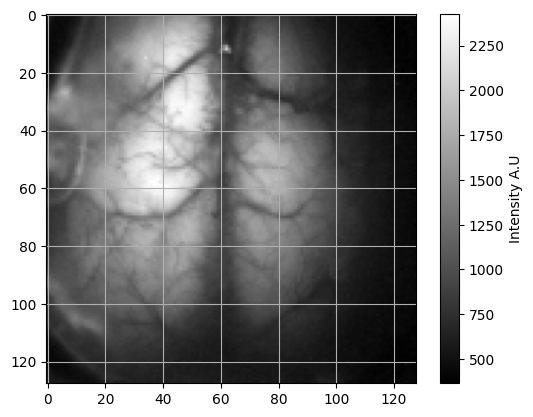

frame number 6000 plotted


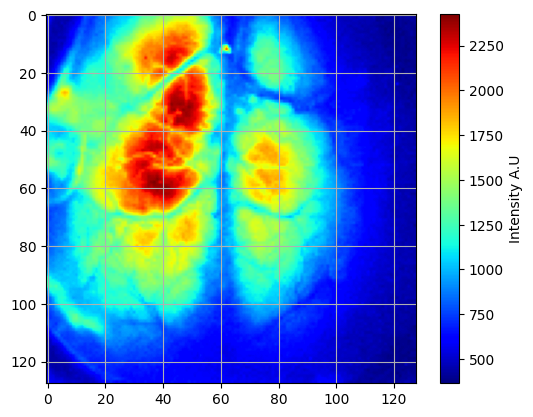

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 425.797119140625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 479.0217590332031


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 88
Number of double_flash pairs: 44
Number of single_flash: 40
Number of total flashes: 128


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:01<02:56,  1.39s/it]

  2%|█▎                                                                                | 2/128 [00:02<02:59,  1.43s/it]

  2%|█▉                                                                                | 3/128 [00:04<02:51,  1.37s/it]

  3%|██▌                                                                               | 4/128 [00:05<02:50,  1.38s/it]

  4%|███▏                                                                              | 5/128 [00:06<02:50,  1.39s/it]

  5%|███▊                                                                              | 6/128 [00:08<02:48,  1.38s/it]

  5%|████▍                                                                             | 7/128 [00:09<02:47,  1.38s/it]

  6%|█████▏                                                                            | 8/128 [00:11<02:45,  1.38s/it]

  7%|█████▊                                                                            | 9/128 [00:12<02:39,  1.34s/it]

  8%|██████▎                                                                          | 10/128 [00:13<02:39,  1.35s/it]

  9%|██████▉                                                                          | 11/128 [00:15<02:36,  1.34s/it]

  9%|███████▌                                                                         | 12/128 [00:16<02:35,  1.34s/it]

 10%|████████▏                                                                        | 13/128 [00:17<02:38,  1.38s/it]

 11%|████████▊                                                                        | 14/128 [00:19<02:35,  1.36s/it]

 12%|█████████▍                                                                       | 15/128 [00:20<02:33,  1.36s/it]

 12%|██████████▏                                                                      | 16/128 [00:22<02:38,  1.41s/it]

 13%|██████████▊                                                                      | 17/128 [00:23<02:34,  1.39s/it]

 14%|███████████▍                                                                     | 18/128 [00:24<02:30,  1.37s/it]

 15%|████████████                                                                     | 19/128 [00:26<02:27,  1.35s/it]

 16%|████████████▋                                                                    | 20/128 [00:27<02:29,  1.39s/it]

 16%|█████████████▎                                                                   | 21/128 [00:28<02:28,  1.39s/it]

 17%|█████████████▉                                                                   | 22/128 [00:30<02:27,  1.39s/it]

 18%|██████████████▌                                                                  | 23/128 [00:31<02:26,  1.39s/it]

 19%|███████████████▏                                                                 | 24/128 [00:33<02:25,  1.40s/it]

 20%|███████████████▊                                                                 | 25/128 [00:34<02:20,  1.36s/it]

 20%|████████████████▍                                                                | 26/128 [00:35<02:19,  1.37s/it]

 21%|█████████████████                                                                | 27/128 [00:37<02:23,  1.42s/it]

 22%|█████████████████▋                                                               | 28/128 [00:38<02:22,  1.43s/it]

 23%|██████████████████▎                                                              | 29/128 [00:40<02:18,  1.40s/it]

 23%|██████████████████▉                                                              | 30/128 [00:41<02:13,  1.36s/it]

 24%|███████████████████▌                                                             | 31/128 [00:42<02:07,  1.32s/it]

 25%|████████████████████▎                                                            | 32/128 [00:44<02:12,  1.38s/it]

 26%|████████████████████▉                                                            | 33/128 [00:45<02:13,  1.41s/it]

 27%|█████████████████████▌                                                           | 34/128 [00:46<02:09,  1.38s/it]

 27%|██████████████████████▏                                                          | 35/128 [00:48<02:05,  1.35s/it]

 28%|██████████████████████▊                                                          | 36/128 [00:49<02:06,  1.37s/it]

 29%|███████████████████████▍                                                         | 37/128 [00:50<02:05,  1.38s/it]

 30%|████████████████████████                                                         | 38/128 [00:52<02:04,  1.39s/it]

 30%|████████████████████████▋                                                        | 39/128 [00:53<02:01,  1.36s/it]

 31%|█████████████████████████▎                                                       | 40/128 [00:54<01:58,  1.35s/it]

 32%|█████████████████████████▉                                                       | 41/128 [00:56<01:55,  1.33s/it]

 33%|██████████████████████████▌                                                      | 42/128 [00:57<01:54,  1.33s/it]

 34%|███████████████████████████▏                                                     | 43/128 [00:58<01:51,  1.31s/it]

 34%|███████████████████████████▊                                                     | 44/128 [01:00<01:52,  1.34s/it]

 35%|████████████████████████████▍                                                    | 45/128 [01:01<01:51,  1.34s/it]

 36%|█████████████████████████████                                                    | 46/128 [01:02<01:50,  1.34s/it]

 37%|█████████████████████████████▋                                                   | 47/128 [01:04<01:47,  1.32s/it]

 38%|██████████████████████████████▍                                                  | 48/128 [01:05<01:48,  1.36s/it]

 38%|███████████████████████████████                                                  | 49/128 [01:06<01:45,  1.33s/it]

 39%|███████████████████████████████▋                                                 | 50/128 [01:08<01:44,  1.34s/it]

 40%|████████████████████████████████▎                                                | 51/128 [01:09<01:41,  1.32s/it]

 41%|████████████████████████████████▉                                                | 52/128 [01:10<01:40,  1.32s/it]

 41%|█████████████████████████████████▌                                               | 53/128 [01:12<01:41,  1.35s/it]

 42%|██████████████████████████████████▏                                              | 54/128 [01:13<01:40,  1.36s/it]

 43%|██████████████████████████████████▊                                              | 55/128 [01:15<01:40,  1.38s/it]

 44%|███████████████████████████████████▍                                             | 56/128 [01:16<01:38,  1.36s/it]

 45%|████████████████████████████████████                                             | 57/128 [01:17<01:37,  1.37s/it]

 45%|████████████████████████████████████▋                                            | 58/128 [01:19<01:35,  1.37s/it]

 46%|█████████████████████████████████████▎                                           | 59/128 [01:20<01:33,  1.35s/it]

 47%|█████████████████████████████████████▉                                           | 60/128 [01:21<01:33,  1.38s/it]

 48%|██████████████████████████████████████▌                                          | 61/128 [01:23<01:33,  1.39s/it]

 48%|███████████████████████████████████████▏                                         | 62/128 [01:24<01:32,  1.40s/it]

 49%|███████████████████████████████████████▊                                         | 63/128 [01:26<01:28,  1.37s/it]

 50%|████████████████████████████████████████▌                                        | 64/128 [01:27<01:28,  1.38s/it]

 51%|█████████████████████████████████████████▏                                       | 65/128 [01:28<01:25,  1.36s/it]

 52%|█████████████████████████████████████████▊                                       | 66/128 [01:30<01:23,  1.35s/it]

 52%|██████████████████████████████████████████▍                                      | 67/128 [01:31<01:22,  1.35s/it]

 53%|███████████████████████████████████████████                                      | 68/128 [01:32<01:21,  1.35s/it]

 54%|███████████████████████████████████████████▋                                     | 69/128 [01:34<01:19,  1.35s/it]

 55%|████████████████████████████████████████████▎                                    | 70/128 [01:35<01:18,  1.35s/it]

 55%|████████████████████████████████████████████▉                                    | 71/128 [01:37<01:18,  1.38s/it]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [01:38<01:17,  1.39s/it]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [01:39<01:16,  1.38s/it]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [01:41<01:14,  1.38s/it]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [01:42<01:11,  1.35s/it]

 59%|████████████████████████████████████████████████                                 | 76/128 [01:43<01:10,  1.35s/it]

 60%|████████████████████████████████████████████████▋                                | 77/128 [01:45<01:07,  1.33s/it]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [01:46<01:05,  1.32s/it]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [01:47<01:03,  1.30s/it]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [01:48<01:03,  1.32s/it]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [01:50<01:01,  1.32s/it]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [01:51<01:01,  1.33s/it]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [01:52<00:59,  1.33s/it]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [01:54<00:57,  1.31s/it]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [01:55<00:55,  1.29s/it]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [01:56<00:55,  1.31s/it]

 68%|███████████████████████████████████████████████████████                          | 87/128 [01:58<00:55,  1.34s/it]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [01:59<00:53,  1.35s/it]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [02:00<00:52,  1.34s/it]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [02:02<00:49,  1.30s/it]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [02:03<00:49,  1.33s/it]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [02:04<00:46,  1.30s/it]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [02:06<00:45,  1.31s/it]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [02:07<00:45,  1.33s/it]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [02:08<00:44,  1.34s/it]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [02:10<00:42,  1.32s/it]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [02:11<00:40,  1.32s/it]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [02:12<00:39,  1.30s/it]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [02:14<00:38,  1.32s/it]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [02:15<00:37,  1.34s/it]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [02:16<00:36,  1.35s/it]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [02:18<00:34,  1.34s/it]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [02:19<00:33,  1.35s/it]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [02:21<00:33,  1.39s/it]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [02:22<00:31,  1.39s/it]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [02:23<00:30,  1.38s/it]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [02:25<00:28,  1.38s/it]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [02:26<00:27,  1.37s/it]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [02:27<00:25,  1.36s/it]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [02:29<00:24,  1.34s/it]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [02:30<00:22,  1.34s/it]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [02:31<00:21,  1.36s/it]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [02:33<00:20,  1.36s/it]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [02:34<00:19,  1.38s/it]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [02:36<00:17,  1.38s/it]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [02:37<00:16,  1.37s/it]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [02:38<00:15,  1.37s/it]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [02:40<00:14,  1.41s/it]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [02:41<00:12,  1.38s/it]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [02:43<00:11,  1.43s/it]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [02:44<00:09,  1.39s/it]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [02:45<00:08,  1.39s/it]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [02:47<00:06,  1.38s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [02:48<00:05,  1.37s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [02:49<00:04,  1.36s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [02:51<00:02,  1.36s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [02:52<00:01,  1.35s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [02:53<00:00,  1.38s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [02:53<00:00,  1.36s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 21%|████████████████▉                                                               | 27/128 [00:00<00:00, 262.22it/s]

 42%|█████████████████████████████████▊                                              | 54/128 [00:00<00:00, 231.78it/s]

 61%|████████████████████████████████████████████████▊                               | 78/128 [00:00<00:00, 218.76it/s]

 79%|██████████████████████████████████████████████████████████████▎                | 101/128 [00:00<00:00, 217.37it/s]

 97%|████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:00<00:00, 220.13it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 220.01it/s]

  0%|                                                                                        | 0/34476 [00:00<?, ?it/s]

  0%|                                                                              | 23/34476 [00:00<02:32, 225.57it/s]

  0%|                                                                              | 49/34476 [00:00<02:22, 242.38it/s]

  0%|▏                                                                             | 78/34476 [00:00<02:10, 262.72it/s]

  0%|▏                                                                            | 106/34476 [00:00<02:09, 265.39it/s]

  0%|▎                                                                            | 134/34476 [00:00<02:06, 270.49it/s]

  0%|▎                                                                            | 162/34476 [00:00<02:06, 270.99it/s]

  1%|▍                                                                            | 191/34476 [00:00<02:05, 273.62it/s]

  1%|▍                                                                            | 221/34476 [00:00<02:02, 280.14it/s]

  1%|▌                                                                            | 250/34476 [00:00<02:02, 278.92it/s]

  1%|▌                                                                            | 278/34476 [00:01<02:04, 274.30it/s]

  1%|▋                                                                            | 306/34476 [00:01<02:04, 273.58it/s]

  1%|▋                                                                            | 334/34476 [00:01<02:11, 260.10it/s]

  1%|▊                                                                            | 362/34476 [00:01<02:09, 264.30it/s]

  1%|▊                                                                            | 389/34476 [00:01<02:10, 260.33it/s]

  1%|▉                                                                            | 417/34476 [00:01<02:09, 262.99it/s]

  1%|▉                                                                            | 444/34476 [00:01<02:10, 259.79it/s]

  1%|█                                                                            | 471/34476 [00:01<02:22, 239.32it/s]

  1%|█                                                                            | 501/34476 [00:01<02:13, 253.81it/s]

  2%|█▏                                                                           | 527/34476 [00:02<02:13, 254.15it/s]

  2%|█▏                                                                           | 555/34476 [00:02<02:10, 260.03it/s]

  2%|█▎                                                                           | 582/34476 [00:02<02:18, 245.31it/s]

  2%|█▎                                                                           | 607/34476 [00:02<02:19, 241.94it/s]

  2%|█▍                                                                           | 634/34476 [00:02<02:15, 249.11it/s]

  2%|█▍                                                                           | 663/34476 [00:02<02:11, 257.79it/s]

  2%|█▌                                                                           | 691/34476 [00:02<02:10, 259.78it/s]

  2%|█▌                                                                           | 718/34476 [00:02<02:18, 244.48it/s]

  2%|█▋                                                                           | 747/34476 [00:02<02:11, 256.38it/s]

  2%|█▋                                                                           | 777/34476 [00:02<02:06, 266.47it/s]

  2%|█▊                                                                           | 804/34476 [00:03<02:12, 254.42it/s]

  2%|█▊                                                                           | 830/34476 [00:03<02:11, 255.20it/s]

  2%|█▉                                                                           | 857/34476 [00:03<02:10, 256.67it/s]

  3%|█▉                                                                           | 885/34476 [00:03<02:08, 261.89it/s]

  3%|██                                                                           | 913/34476 [00:03<02:05, 266.37it/s]

  3%|██                                                                           | 940/34476 [00:03<02:07, 262.10it/s]

  3%|██▏                                                                          | 967/34476 [00:03<02:08, 260.64it/s]

  3%|██▏                                                                          | 994/34476 [00:03<02:10, 257.41it/s]

  3%|██▏                                                                         | 1020/34476 [00:03<02:12, 251.65it/s]

  3%|██▎                                                                         | 1046/34476 [00:04<02:11, 253.34it/s]

  3%|██▎                                                                         | 1072/34476 [00:04<02:20, 237.41it/s]

  3%|██▍                                                                         | 1100/34476 [00:04<02:14, 247.90it/s]

  3%|██▍                                                                         | 1126/34476 [00:04<02:16, 244.43it/s]

  3%|██▌                                                                         | 1154/34476 [00:04<02:11, 253.78it/s]

  3%|██▌                                                                         | 1182/34476 [00:04<02:07, 260.58it/s]

  4%|██▋                                                                         | 1209/34476 [00:04<02:16, 243.56it/s]

  4%|██▋                                                                         | 1237/34476 [00:04<02:12, 251.59it/s]

  4%|██▊                                                                         | 1263/34476 [00:04<02:13, 249.07it/s]

  4%|██▊                                                                         | 1289/34476 [00:05<02:14, 247.29it/s]

  4%|██▉                                                                         | 1316/34476 [00:05<02:11, 251.62it/s]

  4%|██▉                                                                         | 1343/34476 [00:05<02:09, 256.18it/s]

  4%|███                                                                         | 1371/34476 [00:05<02:06, 260.85it/s]

  4%|███                                                                         | 1399/34476 [00:05<02:04, 264.91it/s]

  4%|███▏                                                                        | 1426/34476 [00:05<02:04, 265.65it/s]

  4%|███▏                                                                        | 1455/34476 [00:05<02:02, 270.45it/s]

  4%|███▎                                                                        | 1483/34476 [00:05<02:02, 270.11it/s]

  4%|███▎                                                                        | 1511/34476 [00:05<02:01, 271.45it/s]

  4%|███▍                                                                        | 1539/34476 [00:05<02:01, 270.80it/s]

  5%|███▍                                                                        | 1567/34476 [00:06<02:00, 272.73it/s]

  5%|███▌                                                                        | 1595/34476 [00:06<02:00, 273.29it/s]

  5%|███▌                                                                        | 1623/34476 [00:06<02:09, 253.60it/s]

  5%|███▋                                                                        | 1650/34476 [00:06<02:07, 257.49it/s]

  5%|███▋                                                                        | 1676/34476 [00:06<02:12, 248.32it/s]

  5%|███▊                                                                        | 1702/34476 [00:06<02:11, 248.83it/s]

  5%|███▊                                                                        | 1728/34476 [00:06<02:14, 243.05it/s]

  5%|███▊                                                                        | 1756/34476 [00:06<02:09, 252.06it/s]

  5%|███▉                                                                        | 1783/34476 [00:06<02:08, 254.30it/s]

  5%|███▉                                                                        | 1809/34476 [00:07<02:14, 242.69it/s]

  5%|████                                                                        | 1837/34476 [00:07<02:09, 251.64it/s]

  5%|████                                                                        | 1863/34476 [00:07<02:11, 248.39it/s]

  5%|████▏                                                                       | 1890/34476 [00:07<02:08, 253.12it/s]

  6%|████▏                                                                       | 1916/34476 [00:07<02:08, 252.94it/s]

  6%|████▎                                                                       | 1946/34476 [00:07<02:03, 264.30it/s]

  6%|████▎                                                                       | 1973/34476 [00:07<02:06, 256.65it/s]

  6%|████▍                                                                       | 1999/34476 [00:07<02:10, 249.77it/s]

  6%|████▍                                                                       | 2025/34476 [00:07<02:13, 243.71it/s]

  6%|████▌                                                                       | 2050/34476 [00:08<02:22, 226.99it/s]

  6%|████▌                                                                       | 2078/34476 [00:08<02:14, 240.07it/s]

  6%|████▋                                                                       | 2107/34476 [00:08<02:07, 253.27it/s]

  6%|████▋                                                                       | 2136/34476 [00:08<02:04, 260.75it/s]

  6%|████▊                                                                       | 2163/34476 [00:08<02:06, 254.68it/s]

  6%|████▊                                                                       | 2190/34476 [00:08<02:07, 254.01it/s]

  6%|████▉                                                                       | 2216/34476 [00:08<02:15, 238.78it/s]

  7%|████▉                                                                       | 2241/34476 [00:08<02:13, 240.57it/s]

  7%|████▉                                                                       | 2268/34476 [00:08<02:09, 248.16it/s]

  7%|█████                                                                       | 2295/34476 [00:08<02:07, 252.26it/s]

  7%|█████                                                                       | 2322/34476 [00:09<02:05, 256.66it/s]

  7%|█████▏                                                                      | 2349/34476 [00:09<02:04, 259.03it/s]

  7%|█████▏                                                                      | 2376/34476 [00:09<02:02, 261.24it/s]

  7%|█████▎                                                                      | 2403/34476 [00:09<02:05, 254.99it/s]

  7%|█████▎                                                                      | 2433/34476 [00:09<02:00, 264.95it/s]

  7%|█████▍                                                                      | 2462/34476 [00:09<01:57, 271.93it/s]

  7%|█████▍                                                                      | 2490/34476 [00:09<01:59, 267.29it/s]

  7%|█████▌                                                                      | 2518/34476 [00:09<01:58, 270.21it/s]

  7%|█████▌                                                                      | 2547/34476 [00:09<01:56, 273.62it/s]

  7%|█████▋                                                                      | 2576/34476 [00:10<01:55, 275.22it/s]

  8%|█████▋                                                                      | 2606/34476 [00:10<01:53, 281.67it/s]

  8%|█████▊                                                                      | 2635/34476 [00:10<01:58, 267.63it/s]

  8%|█████▊                                                                      | 2664/34476 [00:10<01:56, 272.45it/s]

  8%|█████▉                                                                      | 2692/34476 [00:10<02:05, 254.21it/s]

  8%|█████▉                                                                      | 2721/34476 [00:10<02:01, 261.21it/s]

  8%|██████                                                                      | 2751/34476 [00:10<01:57, 269.08it/s]

  8%|██████▏                                                                     | 2779/34476 [00:10<02:15, 233.21it/s]

  8%|██████▏                                                                     | 2807/34476 [00:10<02:09, 244.03it/s]

  8%|██████▏                                                                     | 2834/34476 [00:11<02:07, 249.01it/s]

  8%|██████▎                                                                     | 2860/34476 [00:11<02:09, 244.65it/s]

  8%|██████▎                                                                     | 2885/34476 [00:11<02:09, 244.13it/s]

  8%|██████▍                                                                     | 2910/34476 [00:11<02:11, 240.40it/s]

  9%|██████▍                                                                     | 2939/34476 [00:11<02:04, 252.99it/s]

  9%|██████▌                                                                     | 2965/34476 [00:11<02:10, 241.87it/s]

  9%|██████▌                                                                     | 2990/34476 [00:11<02:11, 239.48it/s]

  9%|██████▋                                                                     | 3019/34476 [00:11<02:04, 252.30it/s]

  9%|██████▋                                                                     | 3048/34476 [00:11<02:00, 260.12it/s]

  9%|██████▊                                                                     | 3077/34476 [00:11<01:57, 267.20it/s]

  9%|██████▊                                                                     | 3104/34476 [00:12<02:05, 250.61it/s]

  9%|██████▉                                                                     | 3130/34476 [00:12<02:09, 241.78it/s]

  9%|██████▉                                                                     | 3155/34476 [00:12<02:11, 238.01it/s]

  9%|███████                                                                     | 3182/34476 [00:12<02:06, 246.53it/s]

  9%|███████                                                                     | 3212/34476 [00:12<02:00, 259.51it/s]

  9%|███████▏                                                                    | 3239/34476 [00:12<02:01, 256.66it/s]

  9%|███████▏                                                                    | 3267/34476 [00:12<01:59, 260.38it/s]

 10%|███████▎                                                                    | 3294/34476 [00:12<01:58, 262.23it/s]

 10%|███████▎                                                                    | 3321/34476 [00:12<02:06, 246.60it/s]

 10%|███████▍                                                                    | 3349/34476 [00:13<02:02, 253.82it/s]

 10%|███████▍                                                                    | 3375/34476 [00:13<02:06, 246.52it/s]

 10%|███████▍                                                                    | 3402/34476 [00:13<02:03, 252.43it/s]

 10%|███████▌                                                                    | 3430/34476 [00:13<02:00, 258.12it/s]

 10%|███████▌                                                                    | 3458/34476 [00:13<01:57, 263.69it/s]

 10%|███████▋                                                                    | 3486/34476 [00:13<01:56, 266.91it/s]

 10%|███████▋                                                                    | 3513/34476 [00:13<02:05, 246.24it/s]

 10%|███████▊                                                                    | 3538/34476 [00:13<02:08, 241.28it/s]

 10%|███████▊                                                                    | 3566/34476 [00:13<02:03, 250.01it/s]

 10%|███████▉                                                                    | 3594/34476 [00:14<01:59, 257.43it/s]

 11%|███████▉                                                                    | 3622/34476 [00:14<01:57, 263.18it/s]

 11%|████████                                                                    | 3649/34476 [00:14<02:00, 255.89it/s]

 11%|████████                                                                    | 3675/34476 [00:14<02:00, 256.36it/s]

 11%|████████▏                                                                   | 3701/34476 [00:14<02:02, 251.61it/s]

 11%|████████▏                                                                   | 3727/34476 [00:14<02:09, 237.00it/s]

 11%|████████▎                                                                   | 3751/34476 [00:14<02:14, 228.97it/s]

 11%|████████▎                                                                   | 3778/34476 [00:14<02:08, 239.00it/s]

 11%|████████▍                                                                   | 3805/34476 [00:14<02:04, 247.06it/s]

 11%|████████▍                                                                   | 3832/34476 [00:15<02:01, 251.50it/s]

 11%|████████▌                                                                   | 3858/34476 [00:15<02:21, 216.68it/s]

 11%|████████▌                                                                   | 3883/34476 [00:15<02:15, 225.32it/s]

 11%|████████▌                                                                   | 3912/34476 [00:15<02:07, 240.13it/s]

 11%|████████▋                                                                   | 3939/34476 [00:15<02:02, 248.27it/s]

 12%|████████▋                                                                   | 3968/34476 [00:15<01:58, 257.93it/s]

 12%|████████▊                                                                   | 3998/34476 [00:15<01:53, 267.70it/s]

 12%|████████▉                                                                   | 4028/34476 [00:15<01:50, 274.67it/s]

 12%|████████▉                                                                   | 4056/34476 [00:15<02:00, 252.11it/s]

 12%|████████▉                                                                   | 4082/34476 [00:16<02:00, 251.54it/s]

 12%|█████████                                                                   | 4112/34476 [00:16<01:55, 262.90it/s]

 12%|█████████                                                                   | 4139/34476 [00:16<02:06, 240.40it/s]

 12%|█████████▏                                                                  | 4167/34476 [00:16<02:01, 250.40it/s]

 12%|█████████▏                                                                  | 4194/34476 [00:16<01:59, 254.08it/s]

 12%|█████████▎                                                                  | 4220/34476 [00:16<01:58, 254.34it/s]

 12%|█████████▎                                                                  | 4248/34476 [00:16<01:56, 260.22it/s]

 12%|█████████▍                                                                  | 4275/34476 [00:16<01:56, 260.07it/s]

 12%|█████████▍                                                                  | 4302/34476 [00:16<01:56, 259.22it/s]

 13%|█████████▌                                                                  | 4331/34476 [00:16<01:53, 265.09it/s]

 13%|█████████▌                                                                  | 4360/34476 [00:17<01:51, 270.00it/s]

 13%|█████████▋                                                                  | 4388/34476 [00:17<01:54, 263.32it/s]

 13%|█████████▋                                                                  | 4415/34476 [00:17<02:03, 244.25it/s]

 13%|█████████▊                                                                  | 4442/34476 [00:17<02:00, 249.27it/s]

 13%|█████████▊                                                                  | 4468/34476 [00:17<01:59, 250.20it/s]

 13%|█████████▉                                                                  | 4497/34476 [00:17<01:55, 259.31it/s]

 13%|█████████▉                                                                  | 4524/34476 [00:17<01:58, 252.97it/s]

 13%|██████████                                                                  | 4550/34476 [00:17<02:01, 247.29it/s]

 13%|██████████                                                                  | 4575/34476 [00:18<02:13, 224.09it/s]

 13%|██████████▏                                                                 | 4601/34476 [00:18<02:08, 232.45it/s]

 13%|██████████▏                                                                 | 4628/34476 [00:18<02:03, 242.04it/s]

 13%|██████████▎                                                                 | 4653/34476 [00:18<02:06, 234.90it/s]

 14%|██████████▎                                                                 | 4677/34476 [00:18<02:07, 233.10it/s]

 14%|██████████▎                                                                 | 4705/34476 [00:18<02:01, 244.28it/s]

 14%|██████████▍                                                                 | 4732/34476 [00:18<01:58, 250.93it/s]

 14%|██████████▍                                                                 | 4760/34476 [00:18<01:55, 257.13it/s]

 14%|██████████▌                                                                 | 4788/34476 [00:18<01:53, 262.28it/s]

 14%|██████████▌                                                                 | 4815/34476 [00:18<01:52, 263.79it/s]

 14%|██████████▋                                                                 | 4842/34476 [00:19<01:52, 262.55it/s]

 14%|██████████▋                                                                 | 4869/34476 [00:19<01:59, 248.04it/s]

 14%|██████████▊                                                                 | 4899/34476 [00:19<01:53, 260.51it/s]

 14%|██████████▊                                                                 | 4926/34476 [00:19<01:54, 258.09it/s]

 14%|██████████▉                                                                 | 4953/34476 [00:19<01:53, 260.77it/s]

 14%|██████████▉                                                                 | 4980/34476 [00:19<01:55, 255.34it/s]

 15%|███████████                                                                 | 5007/34476 [00:19<01:53, 258.82it/s]

 15%|███████████                                                                 | 5035/34476 [00:19<01:51, 263.45it/s]

 15%|███████████▏                                                                | 5063/34476 [00:19<01:50, 266.74it/s]

 15%|███████████▏                                                                | 5090/34476 [00:19<01:50, 266.94it/s]

 15%|███████████▎                                                                | 5119/34476 [00:20<01:48, 271.36it/s]

 15%|███████████▎                                                                | 5147/34476 [00:20<01:59, 245.10it/s]

 15%|███████████▍                                                                | 5173/34476 [00:20<01:58, 247.84it/s]

 15%|███████████▍                                                                | 5199/34476 [00:20<01:58, 247.80it/s]

 15%|███████████▌                                                                | 5226/34476 [00:20<01:56, 251.26it/s]

 15%|███████████▌                                                                | 5252/34476 [00:20<01:58, 247.42it/s]

 15%|███████████▋                                                                | 5279/34476 [00:20<01:55, 252.43it/s]

 15%|███████████▋                                                                | 5306/34476 [00:20<01:53, 256.78it/s]

 15%|███████████▊                                                                | 5334/34476 [00:20<01:51, 261.28it/s]

 16%|███████████▊                                                                | 5362/34476 [00:21<01:50, 264.45it/s]

 16%|███████████▉                                                                | 5389/34476 [00:21<01:54, 254.21it/s]

 16%|███████████▉                                                                | 5415/34476 [00:21<01:55, 252.01it/s]

 16%|███████████▉                                                                | 5441/34476 [00:21<01:58, 245.88it/s]

 16%|████████████                                                                | 5471/34476 [00:21<01:51, 259.04it/s]

 16%|████████████                                                                | 5498/34476 [00:21<01:54, 253.49it/s]

 16%|████████████▏                                                               | 5524/34476 [00:21<01:54, 253.92it/s]

 16%|████████████▏                                                               | 5554/34476 [00:21<01:49, 264.15it/s]

 16%|████████████▎                                                               | 5581/34476 [00:21<01:53, 254.83it/s]

 16%|████████████▎                                                               | 5607/34476 [00:22<01:56, 247.11it/s]

 16%|████████████▍                                                               | 5634/34476 [00:22<01:53, 253.27it/s]

 16%|████████████▍                                                               | 5661/34476 [00:22<01:51, 257.35it/s]

 16%|████████████▌                                                               | 5687/34476 [00:22<01:53, 253.73it/s]

 17%|████████████▌                                                               | 5713/34476 [00:22<01:53, 253.37it/s]

 17%|████████████▋                                                               | 5743/34476 [00:22<01:48, 265.40it/s]

 17%|████████████▋                                                               | 5770/34476 [00:22<01:52, 255.58it/s]

 17%|████████████▊                                                               | 5796/34476 [00:22<01:54, 251.13it/s]

 17%|████████████▊                                                               | 5822/34476 [00:22<01:55, 248.72it/s]

 17%|████████████▉                                                               | 5847/34476 [00:23<02:03, 231.29it/s]

 17%|████████████▉                                                               | 5871/34476 [00:23<02:06, 226.25it/s]

 17%|█████████████                                                               | 5899/34476 [00:23<01:59, 238.44it/s]

 17%|█████████████                                                               | 5926/34476 [00:23<01:55, 246.61it/s]

 17%|█████████████                                                               | 5953/34476 [00:23<01:53, 251.16it/s]

 17%|█████████████▏                                                              | 5979/34476 [00:23<01:59, 238.62it/s]

 17%|█████████████▏                                                              | 6007/34476 [00:23<01:54, 248.80it/s]

 18%|█████████████▎                                                              | 6034/34476 [00:23<01:51, 254.12it/s]

 18%|█████████████▎                                                              | 6061/34476 [00:23<01:50, 257.97it/s]

 18%|█████████████▍                                                              | 6089/34476 [00:23<01:48, 262.12it/s]

 18%|█████████████▍                                                              | 6116/34476 [00:24<01:50, 256.22it/s]

 18%|█████████████▌                                                              | 6143/34476 [00:24<01:49, 257.99it/s]

 18%|█████████████▌                                                              | 6169/34476 [00:24<01:56, 242.82it/s]

 18%|█████████████▋                                                              | 6196/34476 [00:24<01:53, 248.23it/s]

 18%|█████████████▋                                                              | 6221/34476 [00:24<01:55, 245.27it/s]

 18%|█████████████▊                                                              | 6251/34476 [00:24<01:50, 256.57it/s]

 18%|█████████████▊                                                              | 6277/34476 [00:24<01:50, 256.11it/s]

 18%|█████████████▉                                                              | 6304/34476 [00:24<01:48, 259.40it/s]

 18%|█████████████▉                                                              | 6331/34476 [00:24<01:47, 261.75it/s]

 18%|██████████████                                                              | 6358/34476 [00:25<01:47, 261.14it/s]

 19%|██████████████                                                              | 6387/34476 [00:25<01:45, 266.50it/s]

 19%|██████████████▏                                                             | 6416/34476 [00:25<01:43, 270.24it/s]

 19%|██████████████▏                                                             | 6444/34476 [00:25<01:43, 269.96it/s]

 19%|██████████████▎                                                             | 6472/34476 [00:25<01:47, 261.46it/s]

 19%|██████████████▎                                                             | 6500/34476 [00:25<01:45, 264.52it/s]

 19%|██████████████▍                                                             | 6527/34476 [00:25<01:49, 254.40it/s]

 19%|██████████████▍                                                             | 6555/34476 [00:25<01:47, 259.46it/s]

 19%|██████████████▌                                                             | 6583/34476 [00:25<01:45, 263.84it/s]

 19%|██████████████▌                                                             | 6610/34476 [00:25<01:52, 248.44it/s]

 19%|██████████████▋                                                             | 6636/34476 [00:26<01:57, 236.54it/s]

 19%|██████████████▋                                                             | 6663/34476 [00:26<01:53, 245.00it/s]

 19%|██████████████▋                                                             | 6691/34476 [00:26<01:49, 253.39it/s]

 19%|██████████████▊                                                             | 6722/34476 [00:26<01:43, 267.97it/s]

 20%|██████████████▉                                                             | 6750/34476 [00:26<01:47, 257.40it/s]

 20%|██████████████▉                                                             | 6777/34476 [00:26<01:46, 260.17it/s]

 20%|███████████████                                                             | 6805/34476 [00:26<01:44, 263.66it/s]

 20%|███████████████                                                             | 6832/34476 [00:26<01:44, 263.99it/s]

 20%|███████████████                                                             | 6860/34476 [00:26<01:43, 266.34it/s]

 20%|███████████████▏                                                            | 6887/34476 [00:27<01:43, 265.93it/s]

 20%|███████████████▏                                                            | 6914/34476 [00:27<01:43, 266.32it/s]

 20%|███████████████▎                                                            | 6941/34476 [00:27<01:43, 265.63it/s]

 20%|███████████████▎                                                            | 6968/34476 [00:27<01:47, 256.31it/s]

 20%|███████████████▍                                                            | 6994/34476 [00:27<01:47, 255.46it/s]

 20%|███████████████▍                                                            | 7020/34476 [00:27<01:47, 255.32it/s]

 20%|███████████████▌                                                            | 7046/34476 [00:27<01:53, 241.24it/s]

 21%|███████████████▌                                                            | 7074/34476 [00:27<01:49, 250.76it/s]

 21%|███████████████▋                                                            | 7101/34476 [00:27<01:48, 252.50it/s]

 21%|███████████████▋                                                            | 7127/34476 [00:28<01:52, 242.84it/s]

 21%|███████████████▊                                                            | 7156/34476 [00:28<01:47, 254.68it/s]

 21%|███████████████▊                                                            | 7185/34476 [00:28<01:43, 263.28it/s]

 21%|███████████████▉                                                            | 7214/34476 [00:28<01:41, 268.69it/s]

 21%|███████████████▉                                                            | 7242/34476 [00:28<01:40, 269.65it/s]

 21%|████████████████                                                            | 7271/34476 [00:28<01:39, 274.01it/s]

 21%|████████████████                                                            | 7300/34476 [00:28<01:38, 276.29it/s]

 21%|████████████████▏                                                           | 7329/34476 [00:28<01:37, 277.09it/s]

 21%|████████████████▏                                                           | 7357/34476 [00:28<01:45, 256.92it/s]

 21%|████████████████▎                                                           | 7383/34476 [00:28<01:47, 252.18it/s]

 21%|████████████████▎                                                           | 7412/34476 [00:29<01:43, 262.07it/s]

 22%|████████████████▍                                                           | 7442/34476 [00:29<01:39, 270.61it/s]

 22%|████████████████▍                                                           | 7471/34476 [00:29<01:38, 274.64it/s]

 22%|████████████████▌                                                           | 7499/34476 [00:29<01:43, 259.64it/s]

 22%|████████████████▌                                                           | 7526/34476 [00:29<01:48, 247.63it/s]

 22%|████████████████▋                                                           | 7554/34476 [00:29<01:46, 253.75it/s]

 22%|████████████████▋                                                           | 7580/34476 [00:29<01:49, 244.59it/s]

 22%|████████████████▊                                                           | 7609/34476 [00:29<01:45, 255.40it/s]

 22%|████████████████▊                                                           | 7636/34476 [00:29<01:44, 257.36it/s]

 22%|████████████████▉                                                           | 7663/34476 [00:30<01:43, 258.78it/s]

 22%|████████████████▉                                                           | 7689/34476 [00:30<01:51, 240.47it/s]

 22%|█████████████████                                                           | 7717/34476 [00:30<01:46, 250.77it/s]

 22%|█████████████████                                                           | 7747/34476 [00:30<01:41, 262.47it/s]

 23%|█████████████████▏                                                          | 7774/34476 [00:30<01:42, 260.53it/s]

 23%|█████████████████▏                                                          | 7801/34476 [00:30<01:45, 253.81it/s]

 23%|█████████████████▎                                                          | 7830/34476 [00:30<01:42, 261.12it/s]

 23%|█████████████████▎                                                          | 7859/34476 [00:30<01:39, 267.87it/s]

 23%|█████████████████▍                                                          | 7886/34476 [00:30<01:46, 249.10it/s]

 23%|█████████████████▍                                                          | 7916/34476 [00:31<01:41, 261.76it/s]

 23%|█████████████████▌                                                          | 7943/34476 [00:31<01:43, 255.46it/s]

 23%|█████████████████▌                                                          | 7969/34476 [00:31<01:45, 251.81it/s]

 23%|█████████████████▋                                                          | 7998/34476 [00:31<01:41, 261.88it/s]

 23%|█████████████████▋                                                          | 8025/34476 [00:31<01:40, 261.98it/s]

 23%|█████████████████▊                                                          | 8052/34476 [00:31<01:47, 245.20it/s]

 23%|█████████████████▊                                                          | 8080/34476 [00:31<01:43, 254.16it/s]

 24%|█████████████████▊                                                          | 8106/34476 [00:31<01:43, 253.68it/s]

 24%|█████████████████▉                                                          | 8132/34476 [00:31<01:43, 254.78it/s]

 24%|█████████████████▉                                                          | 8159/34476 [00:31<01:42, 257.72it/s]

 24%|██████████████████                                                          | 8185/34476 [00:32<01:41, 258.03it/s]

 24%|██████████████████                                                          | 8213/34476 [00:32<01:40, 262.20it/s]

 24%|██████████████████▏                                                         | 8241/34476 [00:32<01:38, 266.67it/s]

 24%|██████████████████▏                                                         | 8268/34476 [00:32<01:41, 259.27it/s]

 24%|██████████████████▎                                                         | 8298/34476 [00:32<01:37, 268.76it/s]

 24%|██████████████████▎                                                         | 8327/34476 [00:32<01:37, 268.72it/s]

 24%|██████████████████▍                                                         | 8354/34476 [00:32<01:38, 265.28it/s]

 24%|██████████████████▍                                                         | 8383/34476 [00:32<01:36, 269.34it/s]

 24%|██████████████████▌                                                         | 8411/34476 [00:32<01:36, 270.11it/s]

 24%|██████████████████▌                                                         | 8439/34476 [00:33<01:36, 269.87it/s]

 25%|██████████████████▋                                                         | 8467/34476 [00:33<01:36, 270.49it/s]

 25%|██████████████████▋                                                         | 8495/34476 [00:33<01:39, 260.75it/s]

 25%|██████████████████▊                                                         | 8523/34476 [00:33<01:37, 265.50it/s]

 25%|██████████████████▊                                                         | 8550/34476 [00:33<01:39, 260.85it/s]

 25%|██████████████████▉                                                         | 8577/34476 [00:33<01:38, 262.75it/s]

 25%|██████████████████▉                                                         | 8604/34476 [00:33<01:37, 264.12it/s]

 25%|███████████████████                                                         | 8634/34476 [00:33<01:34, 272.62it/s]

 25%|███████████████████                                                         | 8664/34476 [00:33<01:32, 278.23it/s]

 25%|███████████████████▏                                                        | 8693/34476 [00:33<01:32, 279.25it/s]

 25%|███████████████████▏                                                        | 8721/34476 [00:34<01:33, 275.46it/s]

 25%|███████████████████▎                                                        | 8749/34476 [00:34<01:33, 274.41it/s]

 25%|███████████████████▎                                                        | 8777/34476 [00:34<01:36, 267.07it/s]

 26%|███████████████████▍                                                        | 8806/34476 [00:34<01:34, 272.92it/s]

 26%|███████████████████▍                                                        | 8835/34476 [00:34<01:32, 276.31it/s]

 26%|███████████████████▌                                                        | 8865/34476 [00:34<01:30, 281.62it/s]

 26%|███████████████████▌                                                        | 8894/34476 [00:34<01:34, 269.85it/s]

 26%|███████████████████▋                                                        | 8922/34476 [00:34<01:41, 251.30it/s]

 26%|███████████████████▋                                                        | 8948/34476 [00:34<01:40, 253.01it/s]

 26%|███████████████████▊                                                        | 8974/34476 [00:35<01:41, 252.17it/s]

 26%|███████████████████▊                                                        | 9002/34476 [00:35<01:38, 257.88it/s]

 26%|███████████████████▉                                                        | 9028/34476 [00:35<01:46, 239.96it/s]

 26%|███████████████████▉                                                        | 9053/34476 [00:35<01:49, 231.87it/s]

 26%|████████████████████                                                        | 9077/34476 [00:35<01:48, 233.50it/s]

 26%|████████████████████                                                        | 9103/34476 [00:35<01:46, 238.94it/s]

 26%|████████████████████                                                        | 9128/34476 [00:35<01:45, 240.06it/s]

 27%|████████████████████▏                                                       | 9154/34476 [00:35<01:43, 244.40it/s]

 27%|████████████████████▏                                                       | 9184/34476 [00:35<01:37, 258.29it/s]

 27%|████████████████████▎                                                       | 9210/34476 [00:36<01:45, 240.62it/s]

 27%|████████████████████▎                                                       | 9235/34476 [00:36<01:45, 239.91it/s]

 27%|████████████████████▍                                                       | 9260/34476 [00:36<01:45, 239.21it/s]

 27%|████████████████████▍                                                       | 9285/34476 [00:36<01:44, 241.61it/s]

 27%|████████████████████▌                                                       | 9313/34476 [00:36<01:40, 251.25it/s]

 27%|████████████████████▌                                                       | 9339/34476 [00:36<01:40, 250.90it/s]

 27%|████████████████████▋                                                       | 9365/34476 [00:36<01:39, 252.84it/s]

 27%|████████████████████▋                                                       | 9391/34476 [00:36<01:41, 246.30it/s]

 27%|████████████████████▊                                                       | 9419/34476 [00:36<01:38, 253.84it/s]

 27%|████████████████████▊                                                       | 9445/34476 [00:36<01:41, 247.76it/s]

 27%|████████████████████▉                                                       | 9473/34476 [00:37<01:37, 256.58it/s]

 28%|████████████████████▉                                                       | 9503/34476 [00:37<01:33, 266.95it/s]

 28%|█████████████████████                                                       | 9530/34476 [00:37<01:33, 267.44it/s]

 28%|█████████████████████                                                       | 9560/34476 [00:37<01:30, 274.60it/s]

 28%|█████████████████████▏                                                      | 9590/34476 [00:37<01:28, 280.44it/s]

 28%|█████████████████████▏                                                      | 9619/34476 [00:37<01:27, 282.98it/s]

 28%|█████████████████████▎                                                      | 9648/34476 [00:37<01:29, 277.13it/s]

 28%|█████████████████████▎                                                      | 9676/34476 [00:37<01:33, 264.89it/s]

 28%|█████████████████████▍                                                      | 9703/34476 [00:37<01:33, 264.86it/s]

 28%|█████████████████████▍                                                      | 9733/34476 [00:38<01:30, 273.41it/s]

 28%|█████████████████████▌                                                      | 9761/34476 [00:38<01:33, 263.88it/s]

 28%|█████████████████████▌                                                      | 9788/34476 [00:38<01:35, 259.74it/s]

 28%|█████████████████████▋                                                      | 9815/34476 [00:38<01:36, 255.42it/s]

 29%|█████████████████████▋                                                      | 9843/34476 [00:38<01:34, 259.47it/s]

 29%|█████████████████████▊                                                      | 9870/34476 [00:38<01:34, 260.27it/s]

 29%|█████████████████████▊                                                      | 9898/34476 [00:38<01:32, 265.22it/s]

 29%|█████████████████████▉                                                      | 9925/34476 [00:38<01:35, 258.37it/s]

 29%|█████████████████████▉                                                      | 9954/34476 [00:38<01:32, 264.44it/s]

 29%|██████████████████████                                                      | 9982/34476 [00:38<01:31, 268.18it/s]

 29%|█████████████████████▊                                                     | 10010/34476 [00:39<01:30, 270.08it/s]

 29%|█████████████████████▊                                                     | 10039/34476 [00:39<01:29, 273.53it/s]

 29%|█████████████████████▉                                                     | 10067/34476 [00:39<01:29, 273.85it/s]

 29%|█████████████████████▉                                                     | 10096/34476 [00:39<01:27, 277.89it/s]

 29%|██████████████████████                                                     | 10124/34476 [00:39<01:30, 270.56it/s]

 29%|██████████████████████                                                     | 10152/34476 [00:39<01:34, 258.34it/s]

 30%|██████████████████████▏                                                    | 10179/34476 [00:39<01:33, 260.19it/s]

 30%|██████████████████████▏                                                    | 10209/34476 [00:39<01:29, 270.05it/s]

 30%|██████████████████████▎                                                    | 10238/34476 [00:39<01:28, 272.69it/s]

 30%|██████████████████████▎                                                    | 10268/34476 [00:40<01:27, 278.21it/s]

 30%|██████████████████████▍                                                    | 10297/34476 [00:40<01:26, 280.85it/s]

 30%|██████████████████████▍                                                    | 10326/34476 [00:40<01:29, 270.11it/s]

 30%|██████████████████████▌                                                    | 10354/34476 [00:40<01:33, 258.23it/s]

 30%|██████████████████████▌                                                    | 10382/34476 [00:40<01:32, 261.40it/s]

 30%|██████████████████████▋                                                    | 10410/34476 [00:40<01:31, 264.44it/s]

 30%|██████████████████████▋                                                    | 10438/34476 [00:40<01:30, 266.62it/s]

 30%|██████████████████████▊                                                    | 10465/34476 [00:40<01:34, 253.74it/s]

 30%|██████████████████████▊                                                    | 10493/34476 [00:40<01:32, 258.96it/s]

 31%|██████████████████████▉                                                    | 10520/34476 [00:41<01:33, 256.29it/s]

 31%|██████████████████████▉                                                    | 10546/34476 [00:41<01:37, 246.17it/s]

 31%|███████████████████████                                                    | 10574/34476 [00:41<01:33, 254.36it/s]

 31%|███████████████████████                                                    | 10602/34476 [00:41<01:31, 260.06it/s]

 31%|███████████████████████                                                    | 10629/34476 [00:41<01:30, 262.19it/s]

 31%|███████████████████████▏                                                   | 10656/34476 [00:41<01:35, 250.64it/s]

 31%|███████████████████████▏                                                   | 10682/34476 [00:41<01:38, 240.41it/s]

 31%|███████████████████████▎                                                   | 10710/34476 [00:41<01:34, 250.70it/s]

 31%|███████████████████████▎                                                   | 10738/34476 [00:41<01:32, 257.19it/s]

 31%|███████████████████████▍                                                   | 10766/34476 [00:41<01:30, 262.25it/s]

 31%|███████████████████████▍                                                   | 10793/34476 [00:42<01:35, 248.02it/s]

 31%|███████████████████████▌                                                   | 10819/34476 [00:42<01:35, 248.61it/s]

 31%|███████████████████████▌                                                   | 10847/34476 [00:42<01:32, 254.95it/s]

 32%|███████████████████████▋                                                   | 10876/34476 [00:42<01:29, 264.59it/s]

 32%|███████████████████████▋                                                   | 10905/34476 [00:42<01:27, 270.41it/s]

 32%|███████████████████████▊                                                   | 10933/34476 [00:42<01:30, 261.06it/s]

 32%|███████████████████████▊                                                   | 10960/34476 [00:42<01:30, 260.66it/s]

 32%|███████████████████████▉                                                   | 10987/34476 [00:42<01:30, 259.97it/s]

 32%|███████████████████████▉                                                   | 11014/34476 [00:42<01:42, 229.01it/s]

 32%|████████████████████████                                                   | 11043/34476 [00:43<01:36, 243.84it/s]

 32%|████████████████████████                                                   | 11069/34476 [00:43<01:37, 241.04it/s]

 32%|████████████████████████▏                                                  | 11094/34476 [00:43<01:37, 240.22it/s]

 32%|████████████████████████▏                                                  | 11119/34476 [00:43<01:37, 240.29it/s]

 32%|████████████████████████▏                                                  | 11146/34476 [00:43<01:34, 247.32it/s]

 32%|████████████████████████▎                                                  | 11172/34476 [00:43<01:33, 249.55it/s]

 32%|████████████████████████▎                                                  | 11199/34476 [00:43<01:31, 254.75it/s]

 33%|████████████████████████▍                                                  | 11226/34476 [00:43<01:29, 258.47it/s]

 33%|████████████████████████▍                                                  | 11253/34476 [00:43<01:28, 261.12it/s]

 33%|████████████████████████▌                                                  | 11280/34476 [00:44<01:30, 255.48it/s]

 33%|████████████████████████▌                                                  | 11310/34476 [00:44<01:27, 266.09it/s]

 33%|████████████████████████▋                                                  | 11337/34476 [00:44<01:26, 266.48it/s]

 33%|████████████████████████▋                                                  | 11365/34476 [00:44<01:25, 270.07it/s]

 33%|████████████████████████▊                                                  | 11393/34476 [00:44<01:35, 241.05it/s]

 33%|████████████████████████▊                                                  | 11418/34476 [00:44<01:43, 223.51it/s]

 33%|████████████████████████▉                                                  | 11447/34476 [00:44<01:36, 239.09it/s]

 33%|████████████████████████▉                                                  | 11472/34476 [00:44<01:38, 233.83it/s]

 33%|█████████████████████████                                                  | 11500/34476 [00:44<01:33, 245.09it/s]

 33%|█████████████████████████                                                  | 11527/34476 [00:45<01:31, 251.36it/s]

 34%|█████████████████████████▏                                                 | 11553/34476 [00:45<01:40, 227.92it/s]

 34%|█████████████████████████▏                                                 | 11580/34476 [00:45<01:36, 238.04it/s]

 34%|█████████████████████████▎                                                 | 11609/34476 [00:45<01:30, 251.91it/s]

 34%|█████████████████████████▎                                                 | 11637/34476 [00:45<01:28, 258.88it/s]

 34%|█████████████████████████▍                                                 | 11667/34476 [00:45<01:24, 268.38it/s]

 34%|█████████████████████████▍                                                 | 11695/34476 [00:45<01:25, 267.13it/s]

 34%|█████████████████████████▌                                                 | 11722/34476 [00:45<01:26, 263.43it/s]

 34%|█████████████████████████▌                                                 | 11749/34476 [00:45<01:26, 263.83it/s]

 34%|█████████████████████████▌                                                 | 11779/34476 [00:45<01:23, 271.99it/s]

 34%|█████████████████████████▋                                                 | 11807/34476 [00:46<01:23, 271.19it/s]

 34%|█████████████████████████▋                                                 | 11836/34476 [00:46<01:22, 275.90it/s]

 34%|█████████████████████████▊                                                 | 11864/34476 [00:46<01:23, 271.94it/s]

 34%|█████████████████████████▊                                                 | 11893/34476 [00:46<01:21, 275.62it/s]

 35%|█████████████████████████▉                                                 | 11921/34476 [00:46<01:25, 263.80it/s]

 35%|█████████████████████████▉                                                 | 11948/34476 [00:46<01:28, 253.32it/s]

 35%|██████████████████████████                                                 | 11975/34476 [00:46<01:27, 257.29it/s]

 35%|██████████████████████████                                                 | 12002/34476 [00:46<01:26, 258.73it/s]

 35%|██████████████████████████▏                                                | 12028/34476 [00:46<01:27, 256.90it/s]

 35%|██████████████████████████▏                                                | 12056/34476 [00:47<01:25, 262.10it/s]

 35%|██████████████████████████▎                                                | 12086/34476 [00:47<01:22, 270.80it/s]

 35%|██████████████████████████▎                                                | 12114/34476 [00:47<01:26, 258.42it/s]

 35%|██████████████████████████▍                                                | 12140/34476 [00:47<01:27, 256.71it/s]

 35%|██████████████████████████▍                                                | 12170/34476 [00:47<01:23, 266.83it/s]

 35%|██████████████████████████▌                                                | 12197/34476 [00:47<01:27, 255.26it/s]

 35%|██████████████████████████▌                                                | 12224/34476 [00:47<01:26, 257.99it/s]

 36%|██████████████████████████▋                                                | 12252/34476 [00:47<01:25, 261.32it/s]

 36%|██████████████████████████▋                                                | 12279/34476 [00:47<01:24, 263.09it/s]

 36%|██████████████████████████▊                                                | 12306/34476 [00:47<01:24, 263.59it/s]

 36%|██████████████████████████▊                                                | 12333/34476 [00:48<01:24, 261.67it/s]

 36%|██████████████████████████▉                                                | 12362/34476 [00:48<01:22, 269.17it/s]

 36%|██████████████████████████▉                                                | 12389/34476 [00:48<01:23, 264.93it/s]

 36%|███████████████████████████                                                | 12417/34476 [00:48<01:22, 267.79it/s]

 36%|███████████████████████████                                                | 12447/34476 [00:48<01:20, 274.84it/s]

 36%|███████████████████████████▏                                               | 12477/34476 [00:48<01:19, 278.17it/s]

 36%|███████████████████████████▏                                               | 12505/34476 [00:48<01:20, 273.56it/s]

 36%|███████████████████████████▎                                               | 12533/34476 [00:48<01:21, 269.97it/s]

 36%|███████████████████████████▎                                               | 12561/34476 [00:48<01:23, 263.74it/s]

 37%|███████████████████████████▍                                               | 12589/34476 [00:49<01:22, 266.13it/s]

 37%|███████████████████████████▍                                               | 12618/34476 [00:49<01:20, 270.69it/s]

 37%|███████████████████████████▌                                               | 12646/34476 [00:49<01:23, 261.09it/s]

 37%|███████████████████████████▌                                               | 12673/34476 [00:49<01:22, 263.08it/s]

 37%|███████████████████████████▋                                               | 12700/34476 [00:49<01:26, 250.68it/s]

 37%|███████████████████████████▋                                               | 12726/34476 [00:49<01:32, 236.13it/s]

 37%|███████████████████████████▋                                               | 12750/34476 [00:49<01:31, 236.56it/s]

 37%|███████████████████████████▊                                               | 12778/34476 [00:49<01:27, 247.32it/s]

 37%|███████████████████████████▊                                               | 12805/34476 [00:49<01:25, 253.07it/s]

 37%|███████████████████████████▉                                               | 12832/34476 [00:50<01:24, 256.49it/s]

 37%|███████████████████████████▉                                               | 12862/34476 [00:50<01:21, 266.82it/s]

 37%|████████████████████████████                                               | 12889/34476 [00:50<01:24, 255.85it/s]

 37%|████████████████████████████                                               | 12917/34476 [00:50<01:22, 261.26it/s]

 38%|████████████████████████████▏                                              | 12944/34476 [00:50<01:25, 251.50it/s]

 38%|████████████████████████████▏                                              | 12970/34476 [00:50<01:29, 239.10it/s]

 38%|████████████████████████████▎                                              | 12995/34476 [00:50<01:30, 237.55it/s]

 38%|████████████████████████████▎                                              | 13021/34476 [00:50<01:28, 241.14it/s]

 38%|████████████████████████████▍                                              | 13046/34476 [00:50<01:29, 240.27it/s]

 38%|████████████████████████████▍                                              | 13071/34476 [00:50<01:30, 237.00it/s]

 38%|████████████████████████████▍                                              | 13095/34476 [00:51<01:34, 226.93it/s]

 38%|████████████████████████████▌                                              | 13122/34476 [00:51<01:30, 235.68it/s]

 38%|████████████████████████████▌                                              | 13150/34476 [00:51<01:26, 246.93it/s]

 38%|████████████████████████████▋                                              | 13178/34476 [00:51<01:23, 254.23it/s]

 38%|████████████████████████████▋                                              | 13205/34476 [00:51<01:22, 258.06it/s]

 38%|████████████████████████████▊                                              | 13232/34476 [00:51<01:21, 259.30it/s]

 38%|████████████████████████████▊                                              | 13258/34476 [00:51<01:22, 256.53it/s]

 39%|████████████████████████████▉                                              | 13284/34476 [00:51<01:22, 256.08it/s]

 39%|████████████████████████████▉                                              | 13310/34476 [00:51<01:25, 246.42it/s]

 39%|█████████████████████████████                                              | 13338/34476 [00:52<01:23, 253.99it/s]

 39%|█████████████████████████████                                              | 13365/34476 [00:52<01:21, 258.11it/s]

 39%|█████████████████████████████▏                                             | 13393/34476 [00:52<01:20, 261.47it/s]

 39%|█████████████████████████████▏                                             | 13420/34476 [00:52<01:19, 263.21it/s]

 39%|█████████████████████████████▎                                             | 13447/34476 [00:52<01:26, 243.12it/s]

 39%|█████████████████████████████▎                                             | 13472/34476 [00:52<01:28, 237.79it/s]

 39%|█████████████████████████████▎                                             | 13497/34476 [00:52<01:29, 235.32it/s]

 39%|█████████████████████████████▍                                             | 13522/34476 [00:52<01:27, 238.78it/s]

 39%|█████████████████████████████▍                                             | 13550/34476 [00:52<01:23, 249.82it/s]

 39%|█████████████████████████████▌                                             | 13578/34476 [00:53<01:21, 257.81it/s]

 39%|█████████████████████████████▌                                             | 13607/34476 [00:53<01:18, 265.67it/s]

 40%|█████████████████████████████▋                                             | 13635/34476 [00:53<01:17, 269.10it/s]

 40%|█████████████████████████████▋                                             | 13662/34476 [00:53<01:19, 260.21it/s]

 40%|█████████████████████████████▊                                             | 13690/34476 [00:53<01:18, 263.66it/s]

 40%|█████████████████████████████▊                                             | 13717/34476 [00:53<01:21, 254.45it/s]

 40%|█████████████████████████████▉                                             | 13743/34476 [00:53<01:24, 244.25it/s]

 40%|█████████████████████████████▉                                             | 13771/34476 [00:53<01:21, 252.85it/s]

 40%|██████████████████████████████                                             | 13798/34476 [00:53<01:20, 255.57it/s]

 40%|██████████████████████████████                                             | 13826/34476 [00:53<01:19, 260.36it/s]

 40%|██████████████████████████████▏                                            | 13853/34476 [00:54<01:18, 261.66it/s]

 40%|██████████████████████████████▏                                            | 13881/34476 [00:54<01:18, 263.95it/s]

 40%|██████████████████████████████▎                                            | 13908/34476 [00:54<01:18, 262.68it/s]

 40%|██████████████████████████████▎                                            | 13935/34476 [00:54<01:18, 260.28it/s]

 40%|██████████████████████████████▎                                            | 13962/34476 [00:54<01:21, 252.14it/s]

 41%|██████████████████████████████▍                                            | 13989/34476 [00:54<01:19, 256.53it/s]

 41%|██████████████████████████████▍                                            | 14017/34476 [00:54<01:18, 261.82it/s]

 41%|██████████████████████████████▌                                            | 14044/34476 [00:54<01:21, 251.78it/s]

 41%|██████████████████████████████▌                                            | 14071/34476 [00:54<01:19, 256.25it/s]

 41%|██████████████████████████████▋                                            | 14097/34476 [00:55<01:20, 252.27it/s]

 41%|██████████████████████████████▋                                            | 14126/34476 [00:55<01:18, 260.15it/s]

 41%|██████████████████████████████▊                                            | 14153/34476 [00:55<01:17, 262.26it/s]

 41%|██████████████████████████████▊                                            | 14180/34476 [00:55<01:18, 260.00it/s]

 41%|██████████████████████████████▉                                            | 14207/34476 [00:55<01:19, 254.08it/s]

 41%|██████████████████████████████▉                                            | 14233/34476 [00:55<01:24, 238.72it/s]

 41%|███████████████████████████████                                            | 14258/34476 [00:55<01:28, 228.60it/s]

 41%|███████████████████████████████                                            | 14285/34476 [00:55<01:24, 238.57it/s]

 42%|███████████████████████████████▏                                           | 14312/34476 [00:55<01:21, 246.66it/s]

 42%|███████████████████████████████▏                                           | 14340/34476 [00:56<01:19, 253.28it/s]

 42%|███████████████████████████████▎                                           | 14367/34476 [00:56<01:18, 257.36it/s]

 42%|███████████████████████████████▎                                           | 14394/34476 [00:56<01:17, 260.29it/s]

 42%|███████████████████████████████▎                                           | 14421/34476 [00:56<01:16, 262.39it/s]

 42%|███████████████████████████████▍                                           | 14450/34476 [00:56<01:14, 267.39it/s]

 42%|███████████████████████████████▍                                           | 14478/34476 [00:56<01:13, 270.32it/s]

 42%|███████████████████████████████▌                                           | 14506/34476 [00:56<01:17, 256.57it/s]

 42%|███████████████████████████████▌                                           | 14532/34476 [00:56<01:17, 256.12it/s]

 42%|███████████████████████████████▋                                           | 14559/34476 [00:56<01:16, 259.38it/s]

 42%|███████████████████████████████▋                                           | 14589/34476 [00:56<01:13, 268.86it/s]

 42%|███████████████████████████████▊                                           | 14616/34476 [00:57<01:14, 266.88it/s]

 42%|███████████████████████████████▊                                           | 14646/34476 [00:57<01:12, 274.18it/s]

 43%|███████████████████████████████▉                                           | 14674/34476 [00:57<01:14, 264.31it/s]

 43%|███████████████████████████████▉                                           | 14702/34476 [00:57<01:13, 267.89it/s]

 43%|████████████████████████████████                                           | 14729/34476 [00:57<01:13, 268.05it/s]

 43%|████████████████████████████████                                           | 14758/34476 [00:57<01:12, 271.32it/s]

 43%|████████████████████████████████▏                                          | 14786/34476 [00:57<01:20, 245.88it/s]

 43%|████████████████████████████████▏                                          | 14812/34476 [00:57<01:19, 248.40it/s]

 43%|████████████████████████████████▎                                          | 14840/34476 [00:57<01:17, 254.50it/s]

 43%|████████████████████████████████▎                                          | 14866/34476 [00:58<01:23, 235.44it/s]

 43%|████████████████████████████████▍                                          | 14890/34476 [00:58<01:24, 232.29it/s]

 43%|████████████████████████████████▍                                          | 14917/34476 [00:58<01:20, 242.03it/s]

 43%|████████████████████████████████▌                                          | 14945/34476 [00:58<01:17, 250.63it/s]

 43%|████████████████████████████████▌                                          | 14973/34476 [00:58<01:16, 256.11it/s]

 44%|████████████████████████████████▋                                          | 15001/34476 [00:58<01:14, 262.25it/s]

 44%|████████████████████████████████▋                                          | 15029/34476 [00:58<01:13, 265.12it/s]

 44%|████████████████████████████████▊                                          | 15056/34476 [00:58<01:14, 260.50it/s]

 44%|████████████████████████████████▊                                          | 15084/34476 [00:58<01:13, 264.63it/s]

 44%|████████████████████████████████▉                                          | 15112/34476 [00:58<01:12, 267.58it/s]

 44%|████████████████████████████████▉                                          | 15139/34476 [00:59<01:16, 252.78it/s]

 44%|████████████████████████████████▉                                          | 15165/34476 [00:59<01:24, 227.82it/s]

 44%|█████████████████████████████████                                          | 15194/34476 [00:59<01:19, 242.40it/s]

 44%|█████████████████████████████████                                          | 15224/34476 [00:59<01:15, 256.06it/s]

 44%|█████████████████████████████████▏                                         | 15252/34476 [00:59<01:13, 260.59it/s]

 44%|█████████████████████████████████▏                                         | 15281/34476 [00:59<01:11, 267.43it/s]

 44%|█████████████████████████████████▎                                         | 15309/34476 [00:59<01:12, 262.77it/s]

 44%|█████████████████████████████████▎                                         | 15337/34476 [00:59<01:12, 265.43it/s]

 45%|█████████████████████████████████▍                                         | 15366/34476 [00:59<01:10, 269.42it/s]

 45%|█████████████████████████████████▍                                         | 15395/34476 [01:00<01:09, 273.81it/s]

 45%|█████████████████████████████████▌                                         | 15424/34476 [01:00<01:08, 278.13it/s]

 45%|█████████████████████████████████▌                                         | 15453/34476 [01:00<01:07, 280.39it/s]

 45%|█████████████████████████████████▋                                         | 15482/34476 [01:00<01:10, 270.51it/s]

 45%|█████████████████████████████████▋                                         | 15510/34476 [01:00<01:15, 250.52it/s]

 45%|█████████████████████████████████▊                                         | 15537/34476 [01:00<01:14, 253.78it/s]

 45%|█████████████████████████████████▊                                         | 15564/34476 [01:00<01:13, 256.18it/s]

 45%|█████████████████████████████████▉                                         | 15594/34476 [01:00<01:10, 266.36it/s]

 45%|█████████████████████████████████▉                                         | 15623/34476 [01:00<01:09, 272.37it/s]

 45%|██████████████████████████████████                                         | 15651/34476 [01:01<01:09, 271.46it/s]

 45%|██████████████████████████████████                                         | 15680/34476 [01:01<01:08, 275.28it/s]

 46%|██████████████████████████████████▏                                        | 15709/34476 [01:01<01:07, 278.79it/s]

 46%|██████████████████████████████████▏                                        | 15737/34476 [01:01<01:08, 275.52it/s]

 46%|██████████████████████████████████▎                                        | 15766/34476 [01:01<01:07, 278.97it/s]

 46%|██████████████████████████████████▎                                        | 15796/34476 [01:01<01:06, 282.70it/s]

 46%|██████████████████████████████████▍                                        | 15825/34476 [01:01<01:07, 276.73it/s]

 46%|██████████████████████████████████▍                                        | 15853/34476 [01:01<01:07, 275.31it/s]

 46%|██████████████████████████████████▌                                        | 15881/34476 [01:01<01:10, 263.66it/s]

 46%|██████████████████████████████████▌                                        | 15908/34476 [01:02<01:16, 243.38it/s]

 46%|██████████████████████████████████▋                                        | 15933/34476 [01:02<01:17, 240.63it/s]

 46%|██████████████████████████████████▋                                        | 15960/34476 [01:02<01:14, 248.06it/s]

 46%|██████████████████████████████████▊                                        | 15989/34476 [01:02<01:11, 257.72it/s]

 46%|██████████████████████████████████▊                                        | 16015/34476 [01:02<01:13, 251.93it/s]

 47%|██████████████████████████████████▉                                        | 16041/34476 [01:02<01:13, 251.03it/s]

 47%|██████████████████████████████████▉                                        | 16067/34476 [01:02<01:13, 250.75it/s]

 47%|███████████████████████████████████                                        | 16093/34476 [01:02<01:12, 252.71it/s]

 47%|███████████████████████████████████                                        | 16119/34476 [01:02<01:14, 247.65it/s]

 47%|███████████████████████████████████                                        | 16144/34476 [01:02<01:16, 239.40it/s]

 47%|███████████████████████████████████▏                                       | 16171/34476 [01:03<01:14, 246.71it/s]

 47%|███████████████████████████████████▏                                       | 16196/34476 [01:03<01:15, 243.48it/s]

 47%|███████████████████████████████████▎                                       | 16221/34476 [01:03<01:16, 239.86it/s]

 47%|███████████████████████████████████▎                                       | 16249/34476 [01:03<01:12, 250.64it/s]

 47%|███████████████████████████████████▍                                       | 16275/34476 [01:03<01:14, 244.18it/s]

 47%|███████████████████████████████████▍                                       | 16300/34476 [01:03<01:14, 243.09it/s]

 47%|███████████████████████████████████▌                                       | 16325/34476 [01:03<01:16, 236.08it/s]

 47%|███████████████████████████████████▌                                       | 16349/34476 [01:03<01:17, 233.25it/s]

 48%|███████████████████████████████████▋                                       | 16377/34476 [01:03<01:14, 243.81it/s]

 48%|███████████████████████████████████▋                                       | 16405/34476 [01:04<01:11, 253.48it/s]

 48%|███████████████████████████████████▋                                       | 16431/34476 [01:04<01:11, 252.47it/s]

 48%|███████████████████████████████████▊                                       | 16459/34476 [01:04<01:09, 257.87it/s]

 48%|███████████████████████████████████▊                                       | 16488/34476 [01:04<01:08, 264.17it/s]

 48%|███████████████████████████████████▉                                       | 16515/34476 [01:04<01:13, 244.52it/s]

 48%|███████████████████████████████████▉                                       | 16541/34476 [01:04<01:12, 247.46it/s]

 48%|████████████████████████████████████                                       | 16568/34476 [01:04<01:11, 251.72it/s]

 48%|████████████████████████████████████                                       | 16596/34476 [01:04<01:09, 258.35it/s]

 48%|████████████████████████████████████▏                                      | 16622/34476 [01:04<01:09, 257.36it/s]

 48%|████████████████████████████████████▏                                      | 16651/34476 [01:04<01:07, 264.57it/s]

 48%|████████████████████████████████████▎                                      | 16679/34476 [01:05<01:07, 265.23it/s]

 48%|████████████████████████████████████▎                                      | 16707/34476 [01:05<01:06, 268.78it/s]

 49%|████████████████████████████████████▍                                      | 16735/34476 [01:05<01:05, 269.72it/s]

 49%|████████████████████████████████████▍                                      | 16763/34476 [01:05<01:05, 271.97it/s]

 49%|████████████████████████████████████▌                                      | 16792/34476 [01:05<01:04, 274.47it/s]

 49%|████████████████████████████████████▌                                      | 16820/34476 [01:05<01:06, 265.20it/s]

 49%|████████████████████████████████████▋                                      | 16847/34476 [01:05<01:10, 251.43it/s]

 49%|████████████████████████████████████▋                                      | 16875/34476 [01:05<01:08, 256.57it/s]

 49%|████████████████████████████████████▊                                      | 16902/34476 [01:05<01:07, 259.66it/s]

 49%|████████████████████████████████████▊                                      | 16932/34476 [01:06<01:05, 268.19it/s]

 49%|████████████████████████████████████▉                                      | 16959/34476 [01:06<01:06, 264.16it/s]

 49%|████████████████████████████████████▉                                      | 16986/34476 [01:06<01:07, 257.33it/s]

 49%|█████████████████████████████████████                                      | 17014/34476 [01:06<01:06, 261.63it/s]

 49%|█████████████████████████████████████                                      | 17042/34476 [01:06<01:05, 266.17it/s]

 50%|█████████████████████████████████████▏                                     | 17070/34476 [01:06<01:04, 267.88it/s]

 50%|█████████████████████████████████████▏                                     | 17097/34476 [01:06<01:05, 264.67it/s]

 50%|█████████████████████████████████████▎                                     | 17125/34476 [01:06<01:04, 267.60it/s]

 50%|█████████████████████████████████████▎                                     | 17152/34476 [01:06<01:05, 263.70it/s]

 50%|█████████████████████████████████████▎                                     | 17179/34476 [01:06<01:05, 264.79it/s]

 50%|█████████████████████████████████████▍                                     | 17206/34476 [01:07<01:07, 254.89it/s]

 50%|█████████████████████████████████████▍                                     | 17232/34476 [01:07<01:10, 245.83it/s]

 50%|█████████████████████████████████████▌                                     | 17257/34476 [01:07<01:13, 233.86it/s]

 50%|█████████████████████████████████████▌                                     | 17281/34476 [01:07<01:14, 231.42it/s]

 50%|█████████████████████████████████████▋                                     | 17305/34476 [01:07<01:13, 233.19it/s]

 50%|█████████████████████████████████████▋                                     | 17329/34476 [01:07<01:17, 222.49it/s]

 50%|█████████████████████████████████████▊                                     | 17357/34476 [01:07<01:12, 237.17it/s]

 50%|█████████████████████████████████████▊                                     | 17385/34476 [01:07<01:09, 246.52it/s]

 50%|█████████████████████████████████████▊                                     | 17410/34476 [01:07<01:09, 246.83it/s]

 51%|█████████████████████████████████████▉                                     | 17435/34476 [01:08<01:09, 246.35it/s]

 51%|█████████████████████████████████████▉                                     | 17460/34476 [01:08<01:12, 235.12it/s]

 51%|██████████████████████████████████████                                     | 17484/34476 [01:08<01:14, 229.38it/s]

 51%|██████████████████████████████████████                                     | 17512/34476 [01:08<01:10, 241.63it/s]

 51%|██████████████████████████████████████▏                                    | 17540/34476 [01:08<01:07, 251.88it/s]

 51%|██████████████████████████████████████▏                                    | 17566/34476 [01:08<01:10, 240.36it/s]

 51%|██████████████████████████████████████▎                                    | 17594/34476 [01:08<01:07, 250.46it/s]

 51%|██████████████████████████████████████▎                                    | 17622/34476 [01:08<01:05, 256.72it/s]

 51%|██████████████████████████████████████▍                                    | 17648/34476 [01:08<01:06, 254.75it/s]

 51%|██████████████████████████████████████▍                                    | 17675/34476 [01:09<01:05, 256.96it/s]

 51%|██████████████████████████████████████▌                                    | 17701/34476 [01:09<01:07, 249.88it/s]

 51%|██████████████████████████████████████▌                                    | 17730/34476 [01:09<01:04, 258.45it/s]

 52%|██████████████████████████████████████▋                                    | 17756/34476 [01:09<01:07, 247.53it/s]

 52%|██████████████████████████████████████▋                                    | 17783/34476 [01:09<01:05, 253.39it/s]

 52%|██████████████████████████████████████▋                                    | 17811/34476 [01:09<01:04, 259.57it/s]

 52%|██████████████████████████████████████▊                                    | 17839/34476 [01:09<01:03, 263.29it/s]

 52%|██████████████████████████████████████▊                                    | 17866/34476 [01:09<01:02, 264.75it/s]

 52%|██████████████████████████████████████▉                                    | 17894/34476 [01:09<01:02, 266.90it/s]

 52%|██████████████████████████████████████▉                                    | 17921/34476 [01:09<01:03, 262.45it/s]

 52%|███████████████████████████████████████                                    | 17948/34476 [01:10<01:03, 258.65it/s]

 52%|███████████████████████████████████████                                    | 17974/34476 [01:10<01:05, 251.79it/s]

 52%|███████████████████████████████████████▏                                   | 18000/34476 [01:10<01:05, 253.44it/s]

 52%|███████████████████████████████████████▏                                   | 18026/34476 [01:10<01:06, 247.48it/s]

 52%|███████████████████████████████████████▎                                   | 18052/34476 [01:10<01:05, 249.66it/s]

 52%|███████████████████████████████████████▎                                   | 18080/34476 [01:10<01:03, 257.71it/s]

 53%|███████████████████████████████████████▍                                   | 18106/34476 [01:10<01:03, 256.16it/s]

 53%|███████████████████████████████████████▍                                   | 18132/34476 [01:10<01:04, 255.07it/s]

 53%|███████████████████████████████████████▌                                   | 18160/34476 [01:10<01:02, 260.11it/s]

 53%|███████████████████████████████████████▌                                   | 18187/34476 [01:11<01:02, 259.24it/s]

 53%|███████████████████████████████████████▋                                   | 18215/34476 [01:11<01:01, 263.79it/s]

 53%|███████████████████████████████████████▋                                   | 18243/34476 [01:11<01:01, 265.46it/s]

 53%|███████████████████████████████████████▋                                   | 18270/34476 [01:11<01:02, 260.71it/s]

 53%|███████████████████████████████████████▊                                   | 18297/34476 [01:11<01:06, 242.98it/s]

 53%|███████████████████████████████████████▊                                   | 18323/34476 [01:11<01:05, 245.00it/s]

 53%|███████████████████████████████████████▉                                   | 18352/34476 [01:11<01:03, 254.81it/s]

 53%|███████████████████████████████████████▉                                   | 18378/34476 [01:11<01:03, 254.14it/s]

 53%|████████████████████████████████████████                                   | 18408/34476 [01:11<01:00, 265.05it/s]

 53%|████████████████████████████████████████                                   | 18435/34476 [01:11<01:05, 243.95it/s]

 54%|████████████████████████████████████████▏                                  | 18461/34476 [01:12<01:05, 245.68it/s]

 54%|████████████████████████████████████████▏                                  | 18486/34476 [01:12<01:07, 238.26it/s]

 54%|████████████████████████████████████████▎                                  | 18511/34476 [01:12<01:08, 231.41it/s]

 54%|████████████████████████████████████████▎                                  | 18539/34476 [01:12<01:05, 243.76it/s]

 54%|████████████████████████████████████████▍                                  | 18564/34476 [01:12<01:05, 243.48it/s]

 54%|████████████████████████████████████████▍                                  | 18591/34476 [01:12<01:03, 248.94it/s]

 54%|████████████████████████████████████████▌                                  | 18618/34476 [01:12<01:02, 252.84it/s]

 54%|████████████████████████████████████████▌                                  | 18644/34476 [01:12<01:06, 236.99it/s]

 54%|████████████████████████████████████████▌                                  | 18673/34476 [01:12<01:02, 251.69it/s]

 54%|████████████████████████████████████████▋                                  | 18699/34476 [01:13<01:02, 252.64it/s]

 54%|████████████████████████████████████████▋                                  | 18725/34476 [01:13<01:04, 244.92it/s]

 54%|████████████████████████████████████████▊                                  | 18750/34476 [01:13<01:05, 239.60it/s]

 54%|████████████████████████████████████████▊                                  | 18778/34476 [01:13<01:02, 250.32it/s]

 55%|████████████████████████████████████████▉                                  | 18806/34476 [01:13<01:00, 258.12it/s]

 55%|████████████████████████████████████████▉                                  | 18832/34476 [01:13<01:00, 257.20it/s]

 55%|█████████████████████████████████████████                                  | 18860/34476 [01:13<00:59, 263.11it/s]

 55%|█████████████████████████████████████████                                  | 18888/34476 [01:13<00:58, 264.99it/s]

 55%|█████████████████████████████████████████▏                                 | 18915/34476 [01:13<01:01, 253.13it/s]

 55%|█████████████████████████████████████████▏                                 | 18941/34476 [01:14<01:02, 246.69it/s]

 55%|█████████████████████████████████████████▎                                 | 18966/34476 [01:14<01:05, 235.04it/s]

 55%|█████████████████████████████████████████▎                                 | 18990/34476 [01:14<01:06, 231.95it/s]

 55%|█████████████████████████████████████████▎                                 | 19018/34476 [01:14<01:03, 244.37it/s]

 55%|█████████████████████████████████████████▍                                 | 19046/34476 [01:14<01:00, 253.09it/s]

 55%|█████████████████████████████████████████▍                                 | 19072/34476 [01:14<01:00, 254.37it/s]

 55%|█████████████████████████████████████████▌                                 | 19100/34476 [01:14<00:59, 259.59it/s]

 55%|█████████████████████████████████████████▌                                 | 19129/34476 [01:14<00:57, 266.16it/s]

 56%|█████████████████████████████████████████▋                                 | 19157/34476 [01:14<00:57, 268.66it/s]

 56%|█████████████████████████████████████████▋                                 | 19185/34476 [01:14<00:56, 269.64it/s]

 56%|█████████████████████████████████████████▊                                 | 19213/34476 [01:15<00:56, 270.33it/s]

 56%|█████████████████████████████████████████▊                                 | 19241/34476 [01:15<00:55, 272.40it/s]

 56%|█████████████████████████████████████████▉                                 | 19269/34476 [01:15<00:56, 266.80it/s]

 56%|█████████████████████████████████████████▉                                 | 19298/34476 [01:15<00:55, 272.98it/s]

 56%|██████████████████████████████████████████                                 | 19326/34476 [01:15<00:56, 269.89it/s]

 56%|██████████████████████████████████████████                                 | 19356/34476 [01:15<00:54, 276.27it/s]

 56%|██████████████████████████████████████████▏                                | 19384/34476 [01:15<00:58, 256.43it/s]

 56%|██████████████████████████████████████████▏                                | 19412/34476 [01:15<00:57, 262.29it/s]

 56%|██████████████████████████████████████████▎                                | 19440/34476 [01:15<00:56, 265.08it/s]

 56%|██████████████████████████████████████████▎                                | 19467/34476 [01:16<00:59, 254.13it/s]

 57%|██████████████████████████████████████████▍                                | 19495/34476 [01:16<00:57, 259.96it/s]

 57%|██████████████████████████████████████████▍                                | 19522/34476 [01:16<00:58, 255.56it/s]

 57%|██████████████████████████████████████████▌                                | 19548/34476 [01:16<00:58, 254.68it/s]

 57%|██████████████████████████████████████████▌                                | 19574/34476 [01:16<00:59, 249.09it/s]

 57%|██████████████████████████████████████████▋                                | 19600/34476 [01:16<00:59, 251.50it/s]

 57%|██████████████████████████████████████████▋                                | 19626/34476 [01:16<01:00, 246.86it/s]

 57%|██████████████████████████████████████████▋                                | 19651/34476 [01:16<01:01, 239.56it/s]

 57%|██████████████████████████████████████████▊                                | 19679/34476 [01:16<00:59, 248.92it/s]

 57%|██████████████████████████████████████████▊                                | 19706/34476 [01:16<00:58, 252.81it/s]

 57%|██████████████████████████████████████████▉                                | 19734/34476 [01:17<00:57, 258.45it/s]

 57%|██████████████████████████████████████████▉                                | 19760/34476 [01:17<00:57, 255.95it/s]

 57%|███████████████████████████████████████████                                | 19786/34476 [01:17<00:59, 248.83it/s]

 57%|███████████████████████████████████████████                                | 19811/34476 [01:17<00:59, 247.77it/s]

 58%|███████████████████████████████████████████▏                               | 19836/34476 [01:17<00:59, 245.60it/s]

 58%|███████████████████████████████████████████▏                               | 19861/34476 [01:17<01:00, 239.94it/s]

 58%|███████████████████████████████████████████▎                               | 19886/34476 [01:17<01:00, 241.47it/s]

 58%|███████████████████████████████████████████▎                               | 19914/34476 [01:17<00:57, 251.20it/s]

 58%|███████████████████████████████████████████▍                               | 19942/34476 [01:17<00:56, 258.12it/s]

 58%|███████████████████████████████████████████▍                               | 19970/34476 [01:18<00:55, 262.25it/s]

 58%|███████████████████████████████████████████▌                               | 19998/34476 [01:18<00:54, 265.92it/s]

 58%|███████████████████████████████████████████▌                               | 20025/34476 [01:18<00:59, 242.23it/s]

 58%|███████████████████████████████████████████▌                               | 20053/34476 [01:18<00:57, 252.19it/s]

 58%|███████████████████████████████████████████▋                               | 20081/34476 [01:18<00:55, 258.95it/s]

 58%|███████████████████████████████████████████▋                               | 20109/34476 [01:18<00:54, 262.75it/s]

 58%|███████████████████████████████████████████▊                               | 20136/34476 [01:18<00:56, 255.53it/s]

 58%|███████████████████████████████████████████▊                               | 20162/34476 [01:18<00:57, 249.37it/s]

 59%|███████████████████████████████████████████▉                               | 20190/34476 [01:18<00:55, 255.89it/s]

 59%|███████████████████████████████████████████▉                               | 20218/34476 [01:19<00:54, 259.85it/s]

 59%|████████████████████████████████████████████                               | 20245/34476 [01:19<00:57, 247.14it/s]

 59%|████████████████████████████████████████████                               | 20270/34476 [01:19<01:00, 236.11it/s]

 59%|████████████████████████████████████████████▏                              | 20294/34476 [01:19<01:00, 233.99it/s]

 59%|████████████████████████████████████████████▏                              | 20322/34476 [01:19<00:57, 244.14it/s]

 59%|████████████████████████████████████████████▎                              | 20347/34476 [01:19<01:02, 227.77it/s]

 59%|████████████████████████████████████████████▎                              | 20371/34476 [01:19<01:02, 226.80it/s]

 59%|████████████████████████████████████████████▎                              | 20398/34476 [01:19<00:59, 237.45it/s]

 59%|████████████████████████████████████████████▍                              | 20427/34476 [01:19<00:56, 249.48it/s]

 59%|████████████████████████████████████████████▍                              | 20455/34476 [01:20<00:54, 256.74it/s]

 59%|████████████████████████████████████████████▌                              | 20481/34476 [01:20<00:55, 254.05it/s]

 59%|████████████████████████████████████████████▌                              | 20509/34476 [01:20<00:53, 260.81it/s]

 60%|████████████████████████████████████████████▋                              | 20536/34476 [01:20<00:53, 259.73it/s]

 60%|████████████████████████████████████████████▋                              | 20563/34476 [01:20<00:54, 257.50it/s]

 60%|████████████████████████████████████████████▊                              | 20589/34476 [01:20<00:56, 244.79it/s]

 60%|████████████████████████████████████████████▊                              | 20614/34476 [01:20<00:57, 239.54it/s]

 60%|████████████████████████████████████████████▉                              | 20639/34476 [01:20<00:58, 237.17it/s]

 60%|████████████████████████████████████████████▉                              | 20663/34476 [01:20<01:03, 218.85it/s]

 60%|█████████████████████████████████████████████                              | 20691/34476 [01:20<00:59, 232.89it/s]

 60%|█████████████████████████████████████████████                              | 20719/34476 [01:21<00:56, 245.26it/s]

 60%|█████████████████████████████████████████████▏                             | 20747/34476 [01:21<00:54, 253.67it/s]

 60%|█████████████████████████████████████████████▏                             | 20773/34476 [01:21<00:54, 253.33it/s]

 60%|█████████████████████████████████████████████▎                             | 20802/34476 [01:21<00:52, 262.00it/s]

 60%|█████████████████████████████████████████████▎                             | 20829/34476 [01:21<00:53, 253.31it/s]

 61%|█████████████████████████████████████████████▍                             | 20858/34476 [01:21<00:52, 259.35it/s]

 61%|█████████████████████████████████████████████▍                             | 20885/34476 [01:21<00:53, 255.13it/s]

 61%|█████████████████████████████████████████████▍                             | 20913/34476 [01:21<00:51, 261.48it/s]

 61%|█████████████████████████████████████████████▌                             | 20941/34476 [01:21<00:51, 263.80it/s]

 61%|█████████████████████████████████████████████▌                             | 20968/34476 [01:22<00:54, 247.02it/s]

 61%|█████████████████████████████████████████████▋                             | 20995/34476 [01:22<00:53, 251.58it/s]

 61%|█████████████████████████████████████████████▋                             | 21023/34476 [01:22<00:51, 258.90it/s]

 61%|█████████████████████████████████████████████▊                             | 21050/34476 [01:22<00:54, 246.55it/s]

 61%|█████████████████████████████████████████████▊                             | 21075/34476 [01:22<00:54, 244.14it/s]

 61%|█████████████████████████████████████████████▉                             | 21101/34476 [01:22<00:54, 247.24it/s]

 61%|█████████████████████████████████████████████▉                             | 21126/34476 [01:22<00:55, 242.51it/s]

 61%|██████████████████████████████████████████████                             | 21154/34476 [01:22<00:53, 251.08it/s]

 61%|██████████████████████████████████████████████                             | 21180/34476 [01:22<00:53, 247.27it/s]

 62%|██████████████████████████████████████████████▏                            | 21208/34476 [01:23<00:52, 254.47it/s]

 62%|██████████████████████████████████████████████▏                            | 21236/34476 [01:23<00:51, 258.14it/s]

 62%|██████████████████████████████████████████████▎                            | 21264/34476 [01:23<00:50, 263.72it/s]

 62%|██████████████████████████████████████████████▎                            | 21292/34476 [01:23<00:49, 267.71it/s]

 62%|██████████████████████████████████████████████▍                            | 21319/34476 [01:23<00:49, 263.77it/s]

 62%|██████████████████████████████████████████████▍                            | 21346/34476 [01:23<00:52, 252.36it/s]

 62%|██████████████████████████████████████████████▍                            | 21373/34476 [01:23<00:51, 255.94it/s]

 62%|██████████████████████████████████████████████▌                            | 21402/34476 [01:23<00:49, 263.48it/s]

 62%|██████████████████████████████████████████████▌                            | 21430/34476 [01:23<00:49, 265.98it/s]

 62%|██████████████████████████████████████████████▋                            | 21458/34476 [01:23<00:48, 268.52it/s]

 62%|██████████████████████████████████████████████▋                            | 21486/34476 [01:24<00:48, 268.76it/s]

 62%|██████████████████████████████████████████████▊                            | 21513/34476 [01:24<00:48, 265.27it/s]

 62%|██████████████████████████████████████████████▊                            | 21540/34476 [01:24<00:50, 255.86it/s]

 63%|██████████████████████████████████████████████▉                            | 21566/34476 [01:24<00:52, 246.51it/s]

 63%|██████████████████████████████████████████████▉                            | 21591/34476 [01:24<00:52, 244.77it/s]

 63%|███████████████████████████████████████████████                            | 21616/34476 [01:24<00:53, 240.19it/s]

 63%|███████████████████████████████████████████████                            | 21641/34476 [01:24<00:53, 239.14it/s]

 63%|███████████████████████████████████████████████▏                           | 21668/34476 [01:24<00:52, 245.86it/s]

 63%|███████████████████████████████████████████████▏                           | 21693/34476 [01:24<00:52, 245.66it/s]

 63%|███████████████████████████████████████████████▏                           | 21718/34476 [01:25<00:55, 230.25it/s]

 63%|███████████████████████████████████████████████▎                           | 21742/34476 [01:25<00:57, 221.27it/s]

 63%|███████████████████████████████████████████████▎                           | 21765/34476 [01:25<00:56, 223.08it/s]

 63%|███████████████████████████████████████████████▍                           | 21788/34476 [01:25<00:57, 220.70it/s]

 63%|███████████████████████████████████████████████▍                           | 21811/34476 [01:25<00:56, 222.72it/s]

 63%|███████████████████████████████████████████████▌                           | 21838/34476 [01:25<00:54, 233.63it/s]

 63%|███████████████████████████████████████████████▌                           | 21863/34476 [01:25<00:53, 237.01it/s]

 63%|███████████████████████████████████████████████▌                           | 21891/34476 [01:25<00:50, 248.09it/s]

 64%|███████████████████████████████████████████████▋                           | 21916/34476 [01:25<00:50, 247.95it/s]

 64%|███████████████████████████████████████████████▋                           | 21942/34476 [01:25<00:49, 250.78it/s]

 64%|███████████████████████████████████████████████▊                           | 21968/34476 [01:26<00:50, 248.39it/s]

 64%|███████████████████████████████████████████████▊                           | 21995/34476 [01:26<00:49, 253.99it/s]

 64%|███████████████████████████████████████████████▉                           | 22023/34476 [01:26<00:48, 259.38it/s]

 64%|███████████████████████████████████████████████▉                           | 22052/34476 [01:26<00:46, 268.01it/s]

 64%|████████████████████████████████████████████████                           | 22079/34476 [01:26<00:46, 267.62it/s]

 64%|████████████████████████████████████████████████                           | 22107/34476 [01:26<00:46, 268.14it/s]

 64%|████████████████████████████████████████████████▏                          | 22137/34476 [01:26<00:44, 275.89it/s]

 64%|████████████████████████████████████████████████▏                          | 22166/34476 [01:26<00:44, 277.56it/s]

 64%|████████████████████████████████████████████████▎                          | 22194/34476 [01:26<00:45, 268.79it/s]

 64%|████████████████████████████████████████████████▎                          | 22221/34476 [01:27<00:45, 268.47it/s]

 65%|████████████████████████████████████████████████▍                          | 22249/34476 [01:27<00:45, 269.50it/s]

 65%|████████████████████████████████████████████████▍                          | 22277/34476 [01:27<00:44, 271.80it/s]

 65%|████████████████████████████████████████████████▌                          | 22306/34476 [01:27<00:44, 274.76it/s]

 65%|████████████████████████████████████████████████▌                          | 22334/34476 [01:27<00:43, 275.99it/s]

 65%|████████████████████████████████████████████████▋                          | 22363/34476 [01:27<00:43, 279.33it/s]

 65%|████████████████████████████████████████████████▋                          | 22391/34476 [01:27<00:44, 273.09it/s]

 65%|████████████████████████████████████████████████▊                          | 22420/34476 [01:27<00:43, 274.85it/s]

 65%|████████████████████████████████████████████████▊                          | 22449/34476 [01:27<00:43, 276.26it/s]

 65%|████████████████████████████████████████████████▉                          | 22478/34476 [01:27<00:42, 279.94it/s]

 65%|████████████████████████████████████████████████▉                          | 22507/34476 [01:28<00:43, 272.51it/s]

 65%|█████████████████████████████████████████████████                          | 22536/34476 [01:28<00:43, 275.98it/s]

 65%|█████████████████████████████████████████████████                          | 22564/34476 [01:28<00:45, 264.14it/s]

 66%|█████████████████████████████████████████████████▏                         | 22592/34476 [01:28<00:44, 267.90it/s]

 66%|█████████████████████████████████████████████████▏                         | 22621/34476 [01:28<00:43, 272.71it/s]

 66%|█████████████████████████████████████████████████▎                         | 22650/34476 [01:28<00:42, 275.36it/s]

 66%|█████████████████████████████████████████████████▎                         | 22678/34476 [01:28<00:44, 262.96it/s]

 66%|█████████████████████████████████████████████████▍                         | 22707/34476 [01:28<00:43, 268.33it/s]

 66%|█████████████████████████████████████████████████▍                         | 22735/34476 [01:28<00:43, 270.96it/s]

 66%|█████████████████████████████████████████████████▌                         | 22763/34476 [01:29<00:42, 272.82it/s]

 66%|█████████████████████████████████████████████████▌                         | 22791/34476 [01:29<00:43, 269.43it/s]

 66%|█████████████████████████████████████████████████▋                         | 22819/34476 [01:29<00:45, 257.57it/s]

 66%|█████████████████████████████████████████████████▋                         | 22845/34476 [01:29<00:46, 248.49it/s]

 66%|█████████████████████████████████████████████████▊                         | 22870/34476 [01:29<00:47, 246.87it/s]

 66%|█████████████████████████████████████████████████▊                         | 22895/34476 [01:29<00:48, 240.95it/s]

 66%|█████████████████████████████████████████████████▊                         | 22920/34476 [01:29<00:49, 234.27it/s]

 67%|█████████████████████████████████████████████████▉                         | 22947/34476 [01:29<00:47, 242.93it/s]

 67%|█████████████████████████████████████████████████▉                         | 22974/34476 [01:29<00:46, 249.17it/s]

 67%|██████████████████████████████████████████████████                         | 23000/34476 [01:29<00:47, 243.95it/s]

 67%|██████████████████████████████████████████████████                         | 23026/34476 [01:30<00:46, 247.83it/s]

 67%|██████████████████████████████████████████████████▏                        | 23055/34476 [01:30<00:44, 257.05it/s]

 67%|██████████████████████████████████████████████████▏                        | 23083/34476 [01:30<00:43, 262.96it/s]

 67%|██████████████████████████████████████████████████▎                        | 23110/34476 [01:30<00:43, 264.22it/s]

 67%|██████████████████████████████████████████████████▎                        | 23137/34476 [01:30<00:47, 237.05it/s]

 67%|██████████████████████████████████████████████████▍                        | 23162/34476 [01:30<00:48, 232.37it/s]

 67%|██████████████████████████████████████████████████▍                        | 23188/34476 [01:30<00:47, 238.64it/s]

 67%|██████████████████████████████████████████████████▌                        | 23216/34476 [01:30<00:45, 248.14it/s]

 67%|██████████████████████████████████████████████████▌                        | 23244/34476 [01:30<00:43, 255.75it/s]

 68%|██████████████████████████████████████████████████▋                        | 23272/34476 [01:31<00:43, 260.50it/s]

 68%|██████████████████████████████████████████████████▋                        | 23299/34476 [01:31<00:42, 261.01it/s]

 68%|██████████████████████████████████████████████████▋                        | 23326/34476 [01:31<00:42, 259.87it/s]

 68%|██████████████████████████████████████████████████▊                        | 23353/34476 [01:31<00:46, 241.78it/s]

 68%|██████████████████████████████████████████████████▊                        | 23378/34476 [01:31<00:46, 237.19it/s]

 68%|██████████████████████████████████████████████████▉                        | 23408/34476 [01:31<00:43, 252.53it/s]

 68%|██████████████████████████████████████████████████▉                        | 23438/34476 [01:31<00:41, 263.71it/s]

 68%|███████████████████████████████████████████████████                        | 23466/34476 [01:31<00:41, 266.11it/s]

 68%|███████████████████████████████████████████████████                        | 23493/34476 [01:31<00:42, 259.78it/s]

 68%|███████████████████████████████████████████████████▏                       | 23520/34476 [01:32<00:41, 261.23it/s]

 68%|███████████████████████████████████████████████████▏                       | 23547/34476 [01:32<00:42, 258.56it/s]

 68%|███████████████████████████████████████████████████▎                       | 23573/34476 [01:32<00:42, 255.33it/s]

 68%|███████████████████████████████████████████████████▎                       | 23599/34476 [01:32<00:47, 231.34it/s]

 69%|███████████████████████████████████████████████████▍                       | 23627/34476 [01:32<00:44, 242.58it/s]

 69%|███████████████████████████████████████████████████▍                       | 23656/34476 [01:32<00:42, 253.29it/s]

 69%|███████████████████████████████████████████████████▌                       | 23686/34476 [01:32<00:40, 264.99it/s]

 69%|███████████████████████████████████████████████████▌                       | 23714/34476 [01:32<00:40, 268.54it/s]

 69%|███████████████████████████████████████████████████▋                       | 23742/34476 [01:32<00:42, 252.86it/s]

 69%|███████████████████████████████████████████████████▋                       | 23769/34476 [01:33<00:41, 256.22it/s]

 69%|███████████████████████████████████████████████████▊                       | 23797/34476 [01:33<00:40, 260.76it/s]

 69%|███████████████████████████████████████████████████▊                       | 23824/34476 [01:33<00:42, 250.53it/s]

 69%|███████████████████████████████████████████████████▉                       | 23852/34476 [01:33<00:41, 255.94it/s]

 69%|███████████████████████████████████████████████████▉                       | 23879/34476 [01:33<00:40, 258.83it/s]

 69%|████████████████████████████████████████████████████                       | 23907/34476 [01:33<00:40, 264.14it/s]

 69%|████████████████████████████████████████████████████                       | 23934/34476 [01:33<00:42, 249.22it/s]

 69%|████████████████████████████████████████████████████                       | 23960/34476 [01:33<00:43, 243.47it/s]

 70%|████████████████████████████████████████████████████▏                      | 23985/34476 [01:33<00:43, 242.61it/s]

 70%|████████████████████████████████████████████████████▏                      | 24010/34476 [01:33<00:43, 239.98it/s]

 70%|████████████████████████████████████████████████████▎                      | 24038/34476 [01:34<00:41, 249.23it/s]

 70%|████████████████████████████████████████████████████▎                      | 24066/34476 [01:34<00:40, 256.60it/s]

 70%|████████████████████████████████████████████████████▍                      | 24093/34476 [01:34<00:40, 259.01it/s]

 70%|████████████████████████████████████████████████████▍                      | 24120/34476 [01:34<00:39, 260.71it/s]

 70%|████████████████████████████████████████████████████▌                      | 24147/34476 [01:34<00:40, 258.17it/s]

 70%|████████████████████████████████████████████████████▌                      | 24175/34476 [01:34<00:39, 263.01it/s]

 70%|████████████████████████████████████████████████████▋                      | 24205/34476 [01:34<00:37, 271.47it/s]

 70%|████████████████████████████████████████████████████▋                      | 24233/34476 [01:34<00:40, 250.53it/s]

 70%|████████████████████████████████████████████████████▊                      | 24259/34476 [01:34<00:40, 250.40it/s]

 70%|████████████████████████████████████████████████████▊                      | 24286/34476 [01:35<00:40, 254.50it/s]

 71%|████████████████████████████████████████████████████▉                      | 24312/34476 [01:35<00:40, 251.08it/s]

 71%|████████████████████████████████████████████████████▉                      | 24338/34476 [01:35<00:44, 227.66it/s]

 71%|█████████████████████████████████████████████████████                      | 24365/34476 [01:35<00:42, 237.12it/s]

 71%|█████████████████████████████████████████████████████                      | 24390/34476 [01:35<00:43, 234.24it/s]

 71%|█████████████████████████████████████████████████████                      | 24419/34476 [01:35<00:40, 245.62it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24444/34476 [01:35<00:40, 245.50it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24469/34476 [01:35<00:41, 240.64it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24496/34476 [01:35<00:40, 247.59it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24521/34476 [01:36<00:42, 236.74it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24545/34476 [01:36<00:45, 219.19it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24572/34476 [01:36<00:42, 231.07it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24600/34476 [01:36<00:40, 241.98it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24628/34476 [01:36<00:39, 250.98it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24655/34476 [01:36<00:38, 254.98it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24683/34476 [01:36<00:37, 260.72it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24710/34476 [01:36<00:38, 256.00it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24737/34476 [01:36<00:37, 259.31it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24764/34476 [01:37<00:37, 258.78it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24790/34476 [01:37<00:38, 253.61it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24816/34476 [01:37<00:38, 249.01it/s]

 72%|██████████████████████████████████████████████████████                     | 24844/34476 [01:37<00:37, 255.72it/s]

 72%|██████████████████████████████████████████████████████                     | 24872/34476 [01:37<00:36, 262.00it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24899/34476 [01:37<00:38, 250.49it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24927/34476 [01:37<00:37, 257.34it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24957/34476 [01:37<00:35, 267.30it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24984/34476 [01:37<00:35, 267.03it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25012/34476 [01:37<00:35, 267.72it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25039/34476 [01:38<00:36, 257.17it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25065/34476 [01:38<00:36, 256.54it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25091/34476 [01:38<00:37, 251.76it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25120/34476 [01:38<00:35, 262.01it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25147/34476 [01:38<00:35, 261.32it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25174/34476 [01:38<00:37, 250.75it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25200/34476 [01:38<00:38, 237.91it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25224/34476 [01:38<00:39, 234.00it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25251/34476 [01:38<00:38, 242.02it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25279/34476 [01:39<00:36, 250.66it/s]

 73%|███████████████████████████████████████████████████████                    | 25306/34476 [01:39<00:35, 255.49it/s]

 73%|███████████████████████████████████████████████████████                    | 25332/34476 [01:39<00:38, 238.20it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25358/34476 [01:39<00:37, 242.92it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25384/34476 [01:39<00:37, 245.69it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25409/34476 [01:39<00:37, 244.88it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25434/34476 [01:39<00:37, 242.86it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25459/34476 [01:39<00:37, 243.54it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25487/34476 [01:39<00:35, 252.70it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25513/34476 [01:39<00:35, 250.47it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25539/34476 [01:40<00:35, 253.23it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25565/34476 [01:40<00:38, 233.35it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25592/34476 [01:40<00:36, 242.86it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25620/34476 [01:40<00:35, 252.32it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25648/34476 [01:40<00:34, 258.07it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25675/34476 [01:40<00:35, 251.37it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25702/34476 [01:40<00:34, 255.24it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25730/34476 [01:40<00:33, 260.14it/s]

 75%|████████████████████████████████████████████████████████                   | 25757/34476 [01:40<00:33, 260.76it/s]

 75%|████████████████████████████████████████████████████████                   | 25784/34476 [01:41<00:33, 261.95it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25811/34476 [01:41<00:33, 259.77it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25840/34476 [01:41<00:32, 267.82it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25869/34476 [01:41<00:31, 271.17it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25897/34476 [01:41<00:31, 272.98it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25925/34476 [01:41<00:33, 259.07it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25952/34476 [01:41<00:34, 247.46it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25978/34476 [01:41<00:34, 248.84it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26005/34476 [01:41<00:33, 251.33it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26031/34476 [01:42<00:34, 242.13it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26060/34476 [01:42<00:33, 254.80it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26087/34476 [01:42<00:32, 257.68it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26115/34476 [01:42<00:31, 262.24it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26142/34476 [01:42<00:33, 249.39it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26170/34476 [01:42<00:32, 255.85it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26198/34476 [01:42<00:31, 260.53it/s]

 76%|█████████████████████████████████████████████████████████                  | 26225/34476 [01:42<00:31, 261.77it/s]

 76%|█████████████████████████████████████████████████████████                  | 26252/34476 [01:42<00:31, 262.75it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26279/34476 [01:42<00:31, 262.62it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26306/34476 [01:43<00:32, 252.97it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26332/34476 [01:43<00:32, 250.01it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26358/34476 [01:43<00:34, 237.94it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26385/34476 [01:43<00:32, 245.50it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26410/34476 [01:43<00:33, 242.68it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26437/34476 [01:43<00:32, 247.65it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26462/34476 [01:43<00:33, 238.77it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26490/34476 [01:43<00:32, 248.34it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26519/34476 [01:43<00:30, 258.79it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26545/34476 [01:44<00:31, 251.89it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26571/34476 [01:44<00:31, 252.07it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26598/34476 [01:44<00:30, 255.06it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26626/34476 [01:44<00:30, 261.18it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26656/34476 [01:44<00:28, 270.18it/s]

 77%|██████████████████████████████████████████████████████████                 | 26684/34476 [01:44<00:28, 272.28it/s]

 77%|██████████████████████████████████████████████████████████                 | 26712/34476 [01:44<00:29, 260.77it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26739/34476 [01:44<00:30, 254.01it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26768/34476 [01:44<00:29, 262.34it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26797/34476 [01:44<00:28, 267.97it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26824/34476 [01:45<00:28, 267.81it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26851/34476 [01:45<00:29, 262.37it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26880/34476 [01:45<00:28, 268.05it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26907/34476 [01:45<00:28, 262.55it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26934/34476 [01:45<00:31, 240.57it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26961/34476 [01:45<00:30, 247.94it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26988/34476 [01:45<00:30, 249.31it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27016/34476 [01:45<00:29, 255.10it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27043/34476 [01:45<00:28, 257.90it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27073/34476 [01:46<00:27, 268.50it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27100/34476 [01:46<00:29, 252.13it/s]

 79%|███████████████████████████████████████████████████████████                | 27130/34476 [01:46<00:27, 262.62it/s]

 79%|███████████████████████████████████████████████████████████                | 27157/34476 [01:46<00:28, 255.33it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27184/34476 [01:46<00:28, 258.38it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27210/34476 [01:46<00:28, 252.38it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27239/34476 [01:46<00:27, 261.62it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27266/34476 [01:46<00:28, 256.67it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27293/34476 [01:46<00:27, 259.03it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27320/34476 [01:47<00:27, 261.46it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27348/34476 [01:47<00:26, 265.34it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27375/34476 [01:47<00:27, 257.69it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27404/34476 [01:47<00:26, 263.97it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27434/34476 [01:47<00:25, 272.05it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27462/34476 [01:47<00:27, 259.33it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27489/34476 [01:47<00:28, 246.40it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27514/34476 [01:47<00:28, 244.06it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27540/34476 [01:47<00:28, 246.47it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27567/34476 [01:48<00:27, 252.44it/s]

 80%|████████████████████████████████████████████████████████████               | 27593/34476 [01:48<00:27, 251.03it/s]

 80%|████████████████████████████████████████████████████████████               | 27619/34476 [01:48<00:27, 245.85it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27646/34476 [01:48<00:27, 251.33it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27672/34476 [01:48<00:27, 246.74it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27701/34476 [01:48<00:26, 256.21it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27727/34476 [01:48<00:28, 237.51it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27752/34476 [01:48<00:28, 235.19it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27779/34476 [01:48<00:27, 244.18it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27804/34476 [01:48<00:28, 234.24it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27830/34476 [01:49<00:27, 239.43it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27855/34476 [01:49<00:27, 237.00it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27884/34476 [01:49<00:26, 248.09it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27909/34476 [01:49<00:26, 247.25it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27934/34476 [01:49<00:27, 239.78it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27959/34476 [01:49<00:27, 235.35it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27983/34476 [01:49<00:27, 236.02it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28008/34476 [01:49<00:27, 238.01it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28036/34476 [01:49<00:25, 248.73it/s]

 81%|█████████████████████████████████████████████████████████████              | 28066/34476 [01:50<00:24, 262.16it/s]

 81%|█████████████████████████████████████████████████████████████              | 28093/34476 [01:50<00:25, 254.08it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28119/34476 [01:50<00:25, 246.61it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28145/34476 [01:50<00:25, 250.39it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28173/34476 [01:50<00:24, 256.76it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28203/34476 [01:50<00:23, 266.99it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28230/34476 [01:50<00:23, 267.12it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28259/34476 [01:50<00:22, 272.25it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28289/34476 [01:50<00:22, 277.18it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28317/34476 [01:50<00:22, 267.82it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28344/34476 [01:51<00:23, 262.44it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28371/34476 [01:51<00:23, 258.70it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28397/34476 [01:51<00:23, 257.63it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28427/34476 [01:51<00:22, 266.81it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28454/34476 [01:51<00:23, 256.37it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28480/34476 [01:51<00:23, 251.71it/s]

 83%|██████████████████████████████████████████████████████████████             | 28506/34476 [01:51<00:23, 252.65it/s]

 83%|██████████████████████████████████████████████████████████████             | 28533/34476 [01:51<00:23, 256.19it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28561/34476 [01:51<00:22, 261.60it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28588/34476 [01:52<00:22, 259.49it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28614/34476 [01:52<00:22, 258.81it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28642/34476 [01:52<00:22, 262.73it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28669/34476 [01:52<00:21, 264.11it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28696/34476 [01:52<00:22, 257.53it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28724/34476 [01:52<00:22, 260.30it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28751/34476 [01:52<00:22, 259.38it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28779/34476 [01:52<00:21, 263.85it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28806/34476 [01:52<00:21, 261.85it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28834/34476 [01:52<00:21, 264.09it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28861/34476 [01:53<00:22, 252.59it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28887/34476 [01:53<00:22, 249.76it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28913/34476 [01:53<00:24, 231.64it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28940/34476 [01:53<00:22, 241.41it/s]

 84%|███████████████████████████████████████████████████████████████            | 28965/34476 [01:53<00:22, 239.82it/s]

 84%|███████████████████████████████████████████████████████████████            | 28992/34476 [01:53<00:22, 246.95it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29021/34476 [01:53<00:21, 257.07it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29048/34476 [01:53<00:20, 259.32it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29075/34476 [01:53<00:21, 256.49it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29105/34476 [01:54<00:20, 266.76it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29132/34476 [01:54<00:20, 255.86it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29161/34476 [01:54<00:20, 264.07it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29191/34476 [01:54<00:19, 272.07it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29219/34476 [01:54<00:20, 259.12it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29246/34476 [01:54<00:22, 234.78it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29272/34476 [01:54<00:21, 239.57it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29298/34476 [01:54<00:21, 243.17it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29323/34476 [01:54<00:21, 236.53it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29351/34476 [01:55<00:20, 247.93it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29380/34476 [01:55<00:19, 257.69it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29408/34476 [01:55<00:19, 261.85it/s]

 85%|████████████████████████████████████████████████████████████████           | 29437/34476 [01:55<00:18, 267.69it/s]

 85%|████████████████████████████████████████████████████████████████           | 29464/34476 [01:55<00:19, 258.63it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29492/34476 [01:55<00:18, 264.00it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29520/34476 [01:55<00:18, 267.11it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29548/34476 [01:55<00:18, 270.10it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29576/34476 [01:55<00:19, 250.97it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29602/34476 [01:56<00:21, 231.03it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29631/34476 [01:56<00:19, 244.13it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29660/34476 [01:56<00:18, 254.59it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29689/34476 [01:56<00:18, 261.58it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29716/34476 [01:56<00:18, 253.25it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29744/34476 [01:56<00:18, 258.58it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29771/34476 [01:56<00:18, 258.90it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29798/34476 [01:56<00:18, 254.11it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29824/34476 [01:56<00:18, 248.75it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29851/34476 [01:57<00:18, 252.64it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29880/34476 [01:57<00:17, 261.85it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29907/34476 [01:57<00:18, 245.12it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29935/34476 [01:57<00:17, 252.70it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29964/34476 [01:57<00:17, 262.99it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29991/34476 [01:57<00:17, 262.26it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30018/34476 [01:57<00:17, 261.50it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30046/34476 [01:57<00:16, 266.11it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30075/34476 [01:57<00:16, 271.72it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30103/34476 [01:57<00:15, 273.51it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30133/34476 [01:58<00:15, 278.88it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30161/34476 [01:58<00:17, 250.47it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30189/34476 [01:58<00:16, 257.88it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30218/34476 [01:58<00:16, 264.70it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30245/34476 [01:58<00:16, 256.03it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30271/34476 [01:58<00:16, 250.14it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30297/34476 [01:58<00:17, 240.76it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30325/34476 [01:58<00:16, 249.56it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30354/34476 [01:58<00:15, 258.78it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30382/34476 [01:59<00:15, 264.11it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30411/34476 [01:59<00:15, 270.83it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30440/34476 [01:59<00:14, 274.84it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30468/34476 [01:59<00:14, 274.36it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30496/34476 [01:59<00:15, 261.47it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30523/34476 [01:59<00:15, 261.69it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30553/34476 [01:59<00:14, 269.62it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30581/34476 [01:59<00:14, 268.00it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30610/34476 [01:59<00:14, 271.24it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30638/34476 [02:00<00:14, 273.01it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30666/34476 [02:00<00:14, 268.80it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30693/34476 [02:00<00:14, 256.55it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30720/34476 [02:00<00:14, 258.92it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30748/34476 [02:00<00:14, 262.73it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30776/34476 [02:00<00:13, 266.76it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30805/34476 [02:00<00:13, 271.19it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30834/34476 [02:00<00:13, 275.10it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30862/34476 [02:00<00:13, 271.79it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30890/34476 [02:00<00:13, 269.49it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30917/34476 [02:01<00:13, 258.41it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30943/34476 [02:01<00:13, 258.15it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30969/34476 [02:01<00:13, 257.97it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30998/34476 [02:01<00:13, 265.01it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31025/34476 [02:01<00:13, 264.94it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31054/34476 [02:01<00:12, 271.52it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31082/34476 [02:01<00:12, 263.19it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31109/34476 [02:01<00:13, 244.75it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31135/34476 [02:01<00:13, 248.29it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31163/34476 [02:02<00:13, 254.38it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31189/34476 [02:02<00:13, 250.30it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31215/34476 [02:02<00:13, 246.77it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31240/34476 [02:02<00:14, 225.91it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31267/34476 [02:02<00:13, 237.20it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31295/34476 [02:02<00:12, 246.38it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31320/34476 [02:02<00:13, 242.63it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31348/34476 [02:02<00:12, 250.40it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31375/34476 [02:02<00:12, 255.30it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31401/34476 [02:02<00:12, 255.94it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31429/34476 [02:03<00:11, 259.95it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31458/34476 [02:03<00:11, 266.42it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31487/34476 [02:03<00:10, 271.75it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31515/34476 [02:03<00:11, 261.17it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31542/34476 [02:03<00:11, 258.55it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31568/34476 [02:03<00:11, 255.35it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31597/34476 [02:03<00:10, 264.67it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31626/34476 [02:03<00:10, 271.26it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31655/34476 [02:03<00:10, 276.59it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31683/34476 [02:04<00:10, 267.38it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31713/34476 [02:04<00:10, 274.44it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31741/34476 [02:04<00:10, 252.64it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31768/34476 [02:04<00:10, 256.73it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31796/34476 [02:04<00:10, 261.83it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31826/34476 [02:04<00:09, 270.44it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31854/34476 [02:04<00:10, 247.56it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31882/34476 [02:04<00:10, 253.64it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31909/34476 [02:04<00:10, 253.97it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31935/34476 [02:05<00:10, 250.77it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31961/34476 [02:05<00:10, 235.46it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31989/34476 [02:05<00:10, 246.95it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32014/34476 [02:05<00:10, 227.47it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32042/34476 [02:05<00:10, 239.02it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32071/34476 [02:05<00:09, 250.31it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32097/34476 [02:05<00:10, 237.13it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32122/34476 [02:05<00:09, 236.79it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32151/34476 [02:05<00:09, 250.85it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32177/34476 [02:06<00:09, 252.04it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32203/34476 [02:06<00:09, 241.87it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32228/34476 [02:06<00:09, 230.60it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32252/34476 [02:06<00:09, 231.93it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32279/34476 [02:06<00:09, 240.49it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32306/34476 [02:06<00:08, 248.11it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32331/34476 [02:06<00:08, 240.36it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32357/34476 [02:06<00:08, 243.90it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32383/34476 [02:06<00:08, 245.72it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32409/34476 [02:07<00:08, 248.28it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32434/34476 [02:07<00:08, 245.06it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32459/34476 [02:07<00:08, 244.03it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32484/34476 [02:07<00:08, 242.27it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32509/34476 [02:07<00:08, 238.31it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32536/34476 [02:07<00:07, 246.05it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32561/34476 [02:07<00:07, 243.68it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32589/34476 [02:07<00:07, 252.05it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32615/34476 [02:07<00:07, 248.60it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32645/34476 [02:07<00:06, 261.97it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32675/34476 [02:08<00:06, 271.49it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32703/34476 [02:08<00:06, 264.72it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32730/34476 [02:08<00:06, 263.23it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32759/34476 [02:08<00:06, 269.44it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32786/34476 [02:08<00:06, 264.25it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32813/34476 [02:08<00:06, 262.14it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32840/34476 [02:08<00:06, 252.38it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32868/34476 [02:08<00:06, 258.03it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32895/34476 [02:08<00:06, 260.74it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32922/34476 [02:09<00:05, 261.93it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32949/34476 [02:09<00:05, 262.78it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32977/34476 [02:09<00:05, 266.29it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33005/34476 [02:09<00:05, 267.20it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33032/34476 [02:09<00:05, 261.16it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33059/34476 [02:09<00:05, 249.10it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33086/34476 [02:09<00:05, 253.78it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33112/34476 [02:09<00:05, 251.16it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33138/34476 [02:09<00:05, 240.63it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33165/34476 [02:09<00:05, 246.11it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33192/34476 [02:10<00:05, 251.47it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33218/34476 [02:10<00:05, 244.14it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33243/34476 [02:10<00:05, 226.61it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33268/34476 [02:10<00:05, 231.10it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33292/34476 [02:10<00:05, 225.45it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33319/34476 [02:10<00:04, 237.15it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33346/34476 [02:10<00:04, 245.08it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33374/34476 [02:10<00:04, 252.13it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33401/34476 [02:10<00:04, 255.93it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33428/34476 [02:11<00:04, 259.29it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33456/34476 [02:11<00:03, 263.07it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33484/34476 [02:11<00:03, 264.95it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33512/34476 [02:11<00:03, 267.81it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33539/34476 [02:11<00:03, 266.92it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33567/34476 [02:11<00:03, 270.00it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33596/34476 [02:11<00:03, 275.12it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33624/34476 [02:11<00:03, 269.42it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33653/34476 [02:11<00:03, 273.85it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33681/34476 [02:11<00:03, 261.14it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33710/34476 [02:12<00:02, 266.34it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33739/34476 [02:12<00:02, 271.59it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33767/34476 [02:12<00:02, 256.96it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33795/34476 [02:12<00:02, 261.96it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33824/34476 [02:12<00:02, 268.23it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33851/34476 [02:12<00:02, 256.25it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33877/34476 [02:12<00:02, 255.18it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33903/34476 [02:12<00:02, 239.58it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33928/34476 [02:12<00:02, 241.06it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33953/34476 [02:13<00:02, 237.58it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33983/34476 [02:13<00:01, 252.34it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34012/34476 [02:13<00:01, 262.33it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34041/34476 [02:13<00:01, 269.56it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34069/34476 [02:13<00:01, 259.05it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34096/34476 [02:13<00:01, 261.39it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34123/34476 [02:13<00:01, 262.43it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34150/34476 [02:13<00:01, 263.89it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34178/34476 [02:13<00:01, 267.06it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34206/34476 [02:14<00:01, 268.52it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34233/34476 [02:14<00:00, 260.57it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34260/34476 [02:14<00:00, 262.56it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34289/34476 [02:14<00:00, 267.47it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34316/34476 [02:14<00:00, 262.87it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34345/34476 [02:14<00:00, 268.81it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34372/34476 [02:14<00:00, 263.05it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34400/34476 [02:14<00:00, 265.67it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34427/34476 [02:14<00:00, 260.89it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34454/34476 [02:14<00:00, 252.61it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34476/34476 [02:15<00:00, 255.26it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


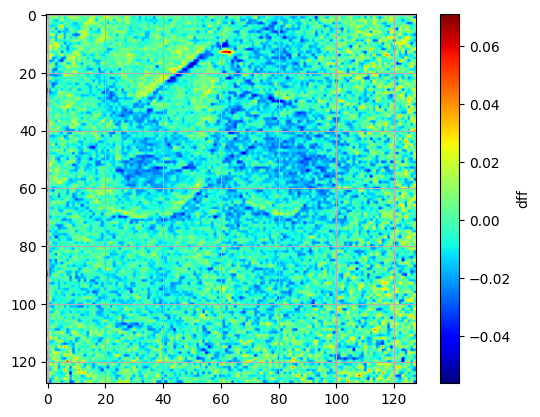

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:44,  2.86it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:39,  3.18it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:37,  3.29it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:38,  3.21it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:36,  3.35it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:35,  3.43it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:35,  3.44it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:37,  3.17it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:38,  3.11it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:37,  3.12it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:36,  3.22it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:35,  3.27it/s]

 10%|████████▏                                                                        | 13/128 [00:03<00:34,  3.35it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:34,  3.33it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:33,  3.40it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:33,  3.30it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:34,  3.25it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:33,  3.26it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:34,  3.16it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:33,  3.20it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:34,  3.13it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:33,  3.15it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:33,  3.11it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:35,  2.92it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:33,  3.04it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:33,  3.08it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:32,  3.07it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:31,  3.13it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:30,  3.23it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:30,  3.23it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:30,  3.23it/s]

 25%|████████████████████▎                                                            | 32/128 [00:10<00:30,  3.16it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:30,  3.15it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:29,  3.14it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:29,  3.17it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:28,  3.20it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:27,  3.27it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:27,  3.27it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:27,  3.26it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:27,  3.16it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:28,  3.09it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:27,  3.13it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:26,  3.25it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:26,  3.19it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:14<00:25,  3.26it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:25,  3.23it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:25,  3.16it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:15<00:25,  3.10it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:25,  3.14it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:24,  3.19it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.24it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:22,  3.30it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:22,  3.29it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:23,  3.20it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:22,  3.25it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:22,  3.26it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:21,  3.35it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:21,  3.23it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:22,  3.12it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:21,  3.21it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:19<00:20,  3.30it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:19,  3.32it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:19,  3.34it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:20,  3.16it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:19,  3.23it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:18,  3.29it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:18,  3.35it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:17,  3.46it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:16,  3.55it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:16,  3.44it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:16,  3.44it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:16,  3.40it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:15,  3.47it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:16,  3.34it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:16,  3.24it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:15,  3.32it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:15,  3.35it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:15,  3.33it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:14,  3.38it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:14,  3.24it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:24<00:14,  3.29it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:13,  3.32it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:13,  3.36it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:13,  3.32it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:12,  3.35it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:12,  3.44it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:12,  3.37it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:12,  3.18it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:12,  3.22it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:11,  3.20it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:11,  3.11it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:11,  3.17it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:10,  3.28it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:28<00:10,  3.24it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:10,  3.26it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:10,  3.16it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:29<00:09,  3.25it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:08,  3.35it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.25it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:30<00:08,  3.23it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:08,  3.21it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:08,  3.21it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:08,  3.10it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:08,  2.86it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:07,  2.92it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:07,  3.04it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:06,  3.04it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:06,  3.08it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:33<00:06,  3.12it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:34<00:05,  3.17it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:05,  3.21it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:05,  3.16it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:35<00:04,  3.19it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:35<00:04,  3.15it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:04,  3.21it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.26it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:36<00:03,  3.36it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:03,  3.28it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:36<00:02,  3.23it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:37<00:02,  3.13it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.08it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.14it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:38<00:01,  3.18it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.27it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.27it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:39<00:00,  3.39it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:39<00:00,  3.44it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.31it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.23it/s]

frame number 200 plotted


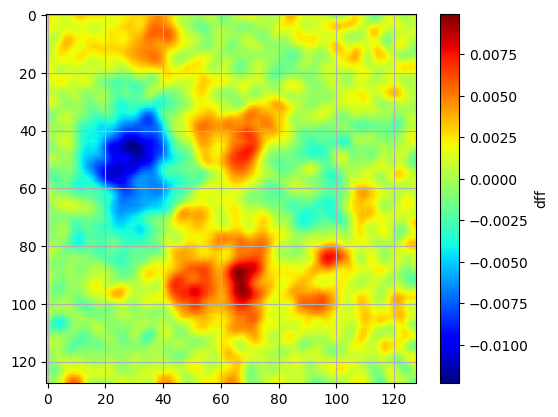

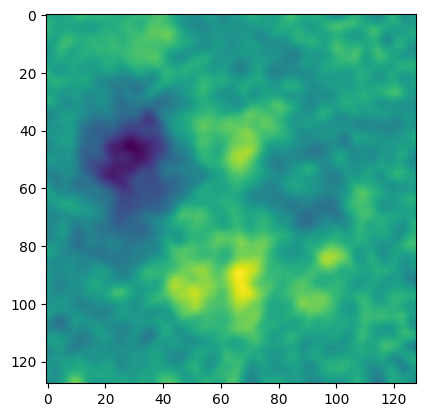

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 16


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 32
fail = 8
total trials = 40


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 30
fail = 14
total trials = 44


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 3
fail = 13
total trials = 16


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34476 [00:00<?, ?it/s]

  6%|████▎                                                                     | 2037/34476 [00:00<00:01, 20175.07it/s]

 13%|█████████▋                                                                | 4499/34476 [00:00<00:01, 22651.17it/s]

 20%|██████████████▌                                                           | 6765/34476 [00:00<00:01, 19175.23it/s]

 27%|███████████████████▉                                                      | 9301/34476 [00:00<00:01, 21294.91it/s]

 33%|████████████████████████▎                                                | 11485/34476 [00:00<00:01, 20004.31it/s]

 39%|████████████████████████████▋                                            | 13575/34476 [00:00<00:01, 20220.42it/s]

 46%|█████████████████████████████████▌                                       | 15831/34476 [00:00<00:00, 20873.12it/s]

 52%|█████████████████████████████████████▉                                   | 17943/34476 [00:00<00:00, 19753.07it/s]

 58%|██████████████████████████████████████████▌                              | 20124/34476 [00:00<00:00, 20292.55it/s]

 64%|██████████████████████████████████████████████▉                          | 22174/34476 [00:01<00:00, 19947.14it/s]

 72%|████████████████████████████████████████████████████▌                    | 24807/34476 [00:01<00:00, 21739.70it/s]

 78%|█████████████████████████████████████████████████████████▎               | 27040/34476 [00:01<00:00, 21850.66it/s]

 86%|██████████████████████████████████████████████████████████████▊          | 29689/34476 [00:01<00:00, 23149.81it/s]

 93%|███████████████████████████████████████████████████████████████████▊     | 32016/34476 [00:01<00:00, 22079.34it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34476/34476 [00:01<00:00, 21381.02it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 11768.86it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 11767.70it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")